## Détection Automatisée des Cellules Cancéreuses dans le Sang

## Problématique
Le  cancer  du  sang,  également  connu  sous  le  nom  de  leucémie,  est  l'un  des  types  de  cancer  les  plus 
répandus  dans  le  monde,  affectant  des  millions  de  personnes  chaque  année.  Un  diagnostic  précoce  et 
précis de cette maladie est crucial pour un traitement efficace et des résultats cliniques optimaux. Dans 
ce  contexte,  les  avancées  récentes  dans  le  domaine  de  l'intelligence  artificielle,  en  particulier  dans  le 
domaine de la vision par ordinateur et de l'apprentissage automatique, offrent de nouvelles possibilités 
pour la détection et la caractérisation des cellules cancéreuses dans les échantillons de sang.
### Introduction
Dans ce document, nous allons explorer l'implémentation de plusieurs modèles pour détecter les cellules sanguines malignes à partir d'images. Nous allons utiliser un ensemble de données provenant de Kaggle, dans le but de former un modèle capable de distinguer entre les cellules bénignes et malignes.

### Jeu do données
Le diagnostic définitif de la leucémie lymphoblastique aiguë (ALL), en tant que cancer très répandu, nécessite des tests de diagnostic invasifs, coûteux et longs. Le diagnostic de la LLA à partir d'images de frottis sanguins périphériques (PBS) joue un rôle vital dans le dépistage initial du cancer parmi les cas non cancéreux. L'examen de ces images PBS par les utilisateurs de laboratoire est parsemé de problèmes tels que l'erreur diagnostique car la nature non spécifique des signes et symptômes de la LLA conduit souvent à un mauvais diagnostic.
Les images de ce jeu de données ont été préparées dans le laboratoire de la moelle osseuse de l'hôpital Taleqani (Téhéran, Iran). Ce jeu de données se composait de 3242 images PBS de 89 patients suspectés de LLA, dont les échantillons de sang ont été préparés et colorés par du personnel de laboratoire qualifié. Ce jeu de données est divisé en deux classes bénigne et maligne. Le premier comprend des hématogènes, et le second est le groupe ALL avec trois sous-types de lymphoblastes malins: Early Pre-B, Pre-B et Pro-B ALL. Toutes les images ont été prises à l'aide d'un appareil photo Zeiss dans un microscope avec un grossissement de 100x et enregistrées sous forme de fichiers JPG. Un spécialiste utilisant l'outil de cytométrie en flux a fait la détermination définitive des types et sous-types de ces cellules.
- Early Pre-B : signifie que les cellules sont dans la phase précoce de la différenciation B.
- Pre-B : signifie que les cellules sont dans la phase intermédiaire de la différenciation B.
- Pro-B : signifie que les cellules sont dans la phase finale de la différenciation B.
- Benign : signifie que les cellules sont normales.

<!-- <img 
    src="https://imgs.search.brave.com/IVoTC_JJZzK1RlCqJA6OlGzT9JYHfe3iHwliD5_H3ls/rs:fit:860:0:0/g:ce/aHR0cHM6Ly93d3cu/bWFjbWlsbGFuLm9y/Zy51ay9kZnNtZWRp/YS8xYTZmMjM1Mzdm/N2Y0NTE5YmIwY2Yx/NGM0NWIyYTYyOS82/MjY4LTUwMDMzL21h/Y2QxNzAtYmxvb2Qt/Y2VsbHMtaW5jLWJs/YXN0LWNlbGxz"
    style="width: 500px; height: 300px"
 /> -->

## Bibliotèques

In [1]:
# Manipulation des données
# ===============================================================
import numpy as np
import pandas as pd

# Data Scaling
from sklearn.preprocessing import StandardScaler

# Traitement d'image
# ===============================================================
import cv2
from scipy import ndimage as ndi
from skimage import morphology
from skimage import io, color, filters, segmentation
from skimage.feature import graycomatrix, graycoprops, peak_local_max
from skimage.color import rgb2gray
from skimage.util import img_as_ubyte
from skimage.measure import label as sk_label 
from skimage.measure import regionprops
from skimage import measure
from skimage.segmentation import watershed
from imutils import paths

# Visualisation des données
# ===============================================================
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import seaborn as sns

# Entrainement
# ===============================================================
from sklearn.model_selection import train_test_split

# model 
# ===============================================================
from sklearn.cluster import KMeans

# Evaluation
# ===============================================================
from sklearn import metrics
from sklearn.metrics import mean_absolute_error,mean_squared_error

# Utilitaires
# ===============================================================
import time
import os
import random
import warnings
warnings.filterwarnings('ignore')


## Préparation du jeu de données

In [5]:
# le chemin du jeu de données (chemin local) 
# voici le url : https://www.kaggle.com/datasets/mohammadamireshraghi/blood-cell-cancer-all-4class
data_path = r'/media/lenovo/3830-5D3C/projet_cv/Blood cell Cancer [ALL]'


In [6]:
categories = [category for category in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, category))]
num_categories = len(categories)
print(f"Le jeu de données contient {num_categories} categories.")

Le jeu de données contient 4 categories.


Afficher une image aléatoire de chaque categorie

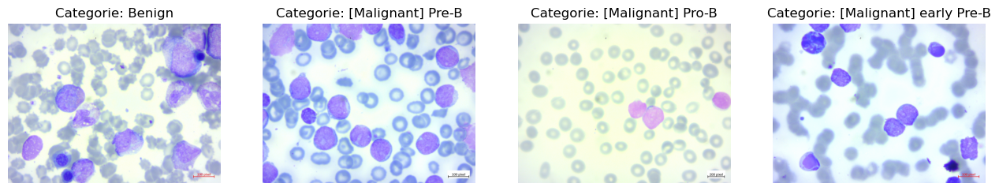

In [4]:
categories = [category for category in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, category))]

fig, axs = plt.subplots(1, 4, figsize=(16, 4))

for ax, category in zip(axs, categories):
    random_image = random.choice(os.listdir(os.path.join(data_path, category)))
    random_image = cv2.imread(os.path.join(data_path, category, random_image))
    random_image = cv2.cvtColor(random_image, cv2.COLOR_BGR2RGB)
    ax.imshow(random_image)
    ax.set_title(f"Categorie: {category}")
    ax.axis('off')

Categorie: Benign, nombre des images: 512
Categorie: [Malignant] Pre-B, nombre des images: 955
Categorie: [Malignant] Pro-B, nombre des images: 796
Categorie: [Malignant] early Pre-B, nombre des images: 979
total des images : 3242


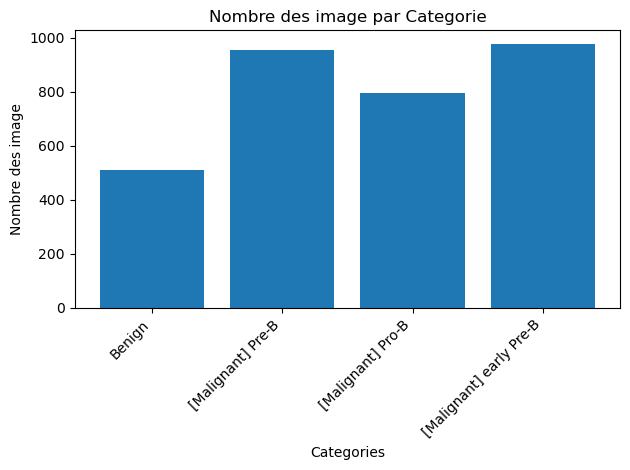

In [7]:
category_counts = {}

categories = [category for category in os.listdir(data_path) if os.path.isdir(os.path.join(data_path, category))]

for category in categories:
    category_dir = os.path.join(data_path, category)
    image_files = [filename for filename in os.listdir(category_dir) if filename.endswith(('.jpg'))]
    category_counts[category] = len(image_files)

for category, count in category_counts.items():
    print(f"Categorie: {category}, nombre des images: {count}")
    
print("total des images :" ,sum(category_counts.values()))

plt.bar(category_counts.keys(), category_counts.values())
plt.xlabel('Categories')
plt.ylabel('Nombre des image')
plt.title('Nombre des image par Categorie')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [24]:
img = cv2.imread(r'/media/lenovo/3830-5D3C/projet_cv/Blood cell Cancer [ALL]/Benign/Sap_013 (10).jpg')
print('Size d\'image: '+str(img.shape))

Size d'image: (768, 1024, 3)


1- créer des dossier pour organiser notre jeu de données

In [11]:
!mkdir ../data/imad

In [ ]:
# vous pouvez decommenter ce code pour créer les dossier

# !mkdir ../data/train_data

# !mkdir ../data/train_data/benign
# !mkdir ../data/train_data/PreB
# !mkdir ../data/train_data/ProB
# !mkdir ../data/train_data/EarlyPreB

# !mkdir ../data/test_data

# !mkdir ../data/test_data/benign
# !mkdir ../data/test_data/PreB
# !mkdir ../data/test_data/ProB
# !mkdir ../data/test_data/EarlyPreB

# !mkdir ../data/segmented_train

# !mkdir ../data/segmented_train/benign
# !mkdir ../data/segmented_train/PreB
# !mkdir ../data/segmented_train/ProB
# !mkdir ../data/segmented_train/EarlyPreB

# !mkdir ../data/segmented_test

# !mkdir ../data/segmented_test/benign
# !mkdir ../data/segmented_test/PreB
# !mkdir ../data/segmented_test/ProB
# !mkdir ../data/segmented_test/EarlyPreB

Nous somme besoin de diviser notre jeu de données en deux ensembles, un pour le test et un pour l'entrainement

In [12]:
data_list = sorted(list(paths.list_images(data_path)))

random.seed(88)

# mélanger les données pour éviter le surapprentissage
random.shuffle(data_list)

train_list, test_list = train_test_split(data_list, train_size=0.8, shuffle=True, random_state=88)

print('Nombre de données pour l\'entrainement  ======:',len(train_list))
print('Nombre de données pour le test ======:',len(test_list))

Nombre de données pour l'entrainement  ======: 2593
Nombre de données pour le test ======: 649


Rennomer les images en fonction de leur classe, puis redimensionner les images pour les rendre plus petites et plus faciles à traiter.
Puis en les enregistrent dans le dossier portant son categorie.

In [13]:
p=0

for img in test_list:
    
    i= cv2.imread(img)    
    i= cv2.resize(i,(224,224))
    label= img.split(os.path.sep)[3]
  
    if (label=="Benign"):
        b= ('../data/test_data/benign/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] Pre-B"):
        b= ('../data/test_data/PreB/'+label+str(p)+'.jpg')  
    if (label=="[Malignant] Pro-B"):
        b= ('../data/test_data/ProB/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] early Pre-B"):
        b= ('../data/test_data/EarlyPreB/'+label+str(p)+'.jpg')
    p+=1
    cv2.imwrite(b,i)

In [ ]:
p=0

for img in train_list:
    
    i= cv2.imread(img)    
    i= cv2.resize(i,(224,224))
    label= img.split(os.path.sep)[3]
    
    if (label=="Benign"):
        b= ('../data/train_data/benign/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] Pre-B"):
        b= ('../data/train_data/PreB/'+label+str(p)+'.jpg')  
    if (label=="[Malignant] Pro-B"):
        b= ('../data/train_data/ProB/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] early Pre-B"):
        b= ('../data/train_data/EarlyPreB/'+label+str(p)+'.jpg')
    p+=1
    cv2.imwrite(b,i)

Ensuite en utilisant la librairie pandas, nous allons créer un DataFrame pour stocker les chemins des images et leurs étiquettes.

In [15]:

prepared_data_path = r'/media/lenovo/3830-5D3C/Blood-cell-detection/data'

prepared_data_list_filenames = (sorted(list(paths.list_images(prepared_data_path))))

print('Nombre de données dans le jeu de données de test :',len(prepared_data_list_filenames))

# shuffle the list to avoid any bias in the data
# bias : means that the model will be trained on a specific class more than the others

random.shuffle(prepared_data_list_filenames)
prepared_data_list_labels = []

for line in prepared_data_list_filenames:
    prepared_data_list_labels.append(line.split(os.path.sep)[7])

I_series = pd.Series(prepared_data_list_filenames, name='filenames')
L_series = pd.Series(prepared_data_list_labels, name='labels')
images_test_df = pd.concat( [I_series, L_series], axis=1) 

print('-- test Datafarame --')

print(images_test_df.head())

#print number of each class:        
a=images_test_df['labels'].value_counts()
print('\n')
print("-- Nombre de chaque cetegorie dans le jeu de données de test --")
a


Nombre de données dans le jeu de données de test : 6484
-- test Datafarame --
                                           filenames     labels
0  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       ProB
1  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       ProB
2  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
3  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       ProB
4  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       ProB


-- Nombre de chaque cetegorie dans le jeu de données de test --


labels
EarlyPreB    1958
PreB         1910
ProB         1592
benign       1024
Name: count, dtype: int64

In [16]:
prepared_data_path = r'/media/lenovo/3830-5D3C/Blood-cell-detection/data/train_data'
prepared_data_list_filenames = (sorted(list(paths.list_images(prepared_data_path))))
random.shuffle(prepared_data_list_filenames)
prepared_data_list_labels = []

for line in prepared_data_list_filenames:
    prepared_data_list_labels.append(line.split(os.path.sep)[7])

I_series = pd.Series(prepared_data_list_filenames, name='filenames')
L_series = pd.Series(prepared_data_list_labels, name='labels')
images_train_df = pd.concat( [I_series, L_series], axis=1) 

print('-- train Datafarame --')

print(images_train_df.head())
#print number of each class:        
a=images_train_df['labels'].value_counts()
print('\n')
print("-- Nombre de chaque cetegorie dans le jeu de données d\'entrainement --")
a

-- train Datafarame --
                                           filenames     labels
0  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
1  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
2  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       PreB
3  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       ProB
4  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB


-- Nombre de chaque cetegorie dans le jeu de données d'entrainement --


labels
EarlyPreB    774
PreB         766
ProB         638
benign       415
Name: count, dtype: int64

## Ségmentation

### Choisir la bonne technique

Nous utiliserons les techniques suivantes pour la segmentation:

**Seuillage** : Le seuillage est la méthode la plus simple de segmentation d'image. À partir d'une image en niveaux de gris, le seuillage peut être utilisé pour créer des images binaires.

**Regroupement** : Le regroupement est une technique de traitement d'image permettant de regrouper les pixels dans une image en fonction de leur similarité.

#### Seuillage

Choisir les bonnes paramétres

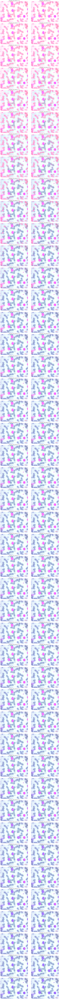

In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image en RGB
image_rgb = cv2.imread(r"/media/lenovo/3830-5D3C/projet_cv/Blood cell Cancer [ALL]/[Malignant] early Pre-B/Sap_148 (1).jpg")

# Convertir l'image RGB en LAB
image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2LAB)

# Extraire le canal A
channel_A = image_lab[:, :, 1]

# Définir les valeurs pour la recherche par grille
threshold_values = range(120, 180, 2)
kernels = [(3, 3), (5, 5), (7, 7)]

# Calculer le nombre total de combinaisons
total_combinations = len(threshold_values) * len(kernels)

# Calculer le nombre de lignes nécessaire
num_rows = total_combinations // 2
if total_combinations % 2 != 0:
    num_rows += 1

# Préparer la disposition de l'affichage
fig, axs = plt.subplots(num_rows, 2, figsize=(15, 5*num_rows))

# Compteur pour suivre la position dans la grille
counter = 0

# Parcourir les valeurs des paramètres
for threshold_value in threshold_values:
    for kernel_size in kernels:
        # Calculer l'indice de ligne et de colonne dans la grille
        row = counter // 2
        col = counter % 2

        # Appliquer le seuillage binaire
        _, thresholded_A = cv2.threshold(channel_A, threshold_value, 255, cv2.THRESH_BINARY)

        # Appliquer la transformation morphologique d'ouverture pour supprimer le bruit
        kernel = np.ones(kernel_size, np.uint8)
        opening = cv2.morphologyEx(thresholded_A, cv2.MORPH_OPEN, kernel)

        # Identifier les contours des cellules
        contours, _ = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Créer un masque pour les cellules malignes
        mask = np.zeros_like(image_rgb)

        # Dessiner les contours des cellules malignes en rouge sur le masque
        cv2.drawContours(mask, contours, -1, (0,0,255), thickness=cv2.FILLED)

        # Fusionner le masque avec l'image originale
        image_with_malignant_cells = cv2.addWeighted(image_rgb, 1, mask, 0.5, 0)

        # Afficher l'image avec les cellules malignes colorées en rouge
        axs[row, col].imshow(cv2.cvtColor(image_with_malignant_cells, cv2.COLOR_BGR2RGB))
        axs[row, col].axis('off')
        axs[row, col].set_title(f"Threshold: {threshold_value}, Kernel: {kernel_size}")

        # Incrémenter le compteur
        counter += 1

# Si le nombre total de combinaisons est impair, la dernière cellule de la dernière ligne doit être vide
if total_combinations % 2 != 0:
    axs[-1, -1].axis('off')

# Afficher l'affichage final
plt.tight_layout()
plt.show()


Alors, visuelement comme resultat; on voit que les valeur entre 140 et 150 sont les meilleurs avec un noyeu de (5,5)

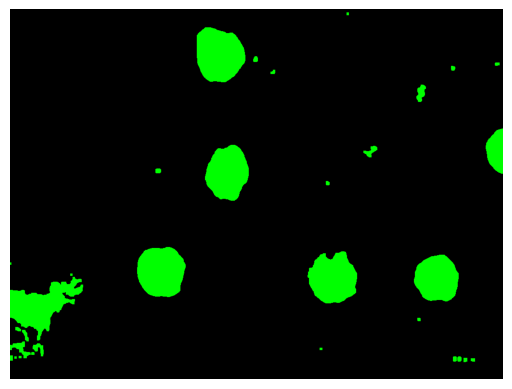

In [18]:
# Charger l'image en RGB
image_rgb = cv2.imread(r"/media/lenovo/3830-5D3C/projet_cv/Blood cell Cancer [ALL]/[Malignant] early Pre-B/Sap_148 (1).jpg")

# Convertir l'image RGB en LAB
image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2LAB)

# Extraire le canal A
channel_A = image_lab[:, :, 1]

# Appliquer le seuillage binaire
_, thresholded_A = cv2.threshold(channel_A, 142, 255, cv2.THRESH_BINARY) 
filled_image = ndi.binary_fill_holes(thresholded_A)
# Convertir l'image booléenne en niveaux de gris
filled_image = filled_image.astype(np.uint8) * 255

# Appliquer la transformation morphologique d'ouverture pour supprimer le bruit
kernel = np.ones((5, 5), np.uint8)
opening = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
cleaned_image = morphology.remove_small_objects(opening, min_size=200)
cleaned_image = morphology.remove_small_holes(cleaned_image, area_threshold=250)
# Identifier les contours des cellules
cleaned_image = cleaned_image.astype(np.uint8) * 255
contours, _ = cv2.findContours(cleaned_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Créer un masque pour les cellules malignes
mask = np.zeros_like(image_rgb)

# Dessiner les contours des cellules malignes
cv2.drawContours(mask, contours, -1, (0,255,0), thickness=cv2.FILLED)

# Fusionner le masque avec l'image originale
image_with_malignant_cells = cv2.addWeighted(image_lab, 1, mask, 0.5, 0)

# Afficher l'image avec les cellules malignes colorées en rouge
plt.imshow(cv2.cvtColor(mask, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [19]:
# Étiqueter les cellules segmentées
labels_thresh = sk_label(opening)

# Extraire les propriétés de chaque cellule
regions_thresh = regionprops(labels_thresh)

# Initialiser des listes pour stocker les caractéristiques
areas = []
perimeters = []
aspect_ratios = []
colors = []
textures = []

for region in regions_thresh:
    # Morphologique
    areas.append(region.area)
    perimeters.append(region.perimeter)
    aspect_ratios.append(region.major_axis_length / region.minor_axis_length)

    # Color 
    minr, minc, maxr, maxc = region.bbox
    cell = image_rgb[minr:maxr, minc:maxc]
    colors.append(np.mean(cell, axis=(0, 1)))

    # Convertir une cellule en niveaux de gris
    cell_gray = rgb2gray(cell)
    cell_gray_ubyte = img_as_ubyte(cell_gray)
    
    # Texture 
    glcm = graycomatrix(cell_gray_ubyte, [5], [0], 256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    textures.append(contrast)


In [20]:
print("Areas: ", areas)
print("Perimeters: ", perimeters)
print("Aspect Ratios: ", aspect_ratios)
print("Colors: ", colors)
print("Textures: ", textures)

Areas:  [30.0, 9076.0, 102.0, 64.0, 79.0, 70.0, 460.0, 2490.0, 7764.0, 323.0, 111.0, 65.0, 8469.0, 8273.0, 7049.0, 15.0, 25.0, 8676.0, 47.0, 85.0, 174.0, 584.0, 328.0, 30.0, 40.0, 66.0, 30.0, 25.0, 83.0, 88.0, 69.0, 60.0]
Perimeters:  [18.0, 363.8061325481598, 35.89949493661167, 28.242640687119284, 31.071067811865476, 32.242640687119284, 98.42640687119285, 226.12489168102786, 344.2914139223983, 92.76955262170047, 36.48528137423857, 27.65685424949238, 349.6639969244288, 380.2914139223983, 317.9066376115481, 12.0, 16.0, 743.7716446627536, 22.82842712474619, 34.48528137423857, 63.21320343559642, 155.84062043356593, 102.8700576850888, 18.0, 20.82842712474619, 30.0, 18.0, 16.0, 31.656854249492376, 31.89949493661166, 29.414213562373096, 27.414213562373096]
Aspect Ratios:  [1.2076147288491197, 1.1480191641500286, 1.271755925345279, 1.5122981346586033, 1.126736186068867, 1.536448139673705, 2.3821857738910466, 2.439715362874407, 1.314521000902557, 1.9925543890903519, 1.2011320104724952, 1.19438

Après avoir extrait les caractéristiques, traçons un rectangle autour de la cellule pour la segmenter du fond.

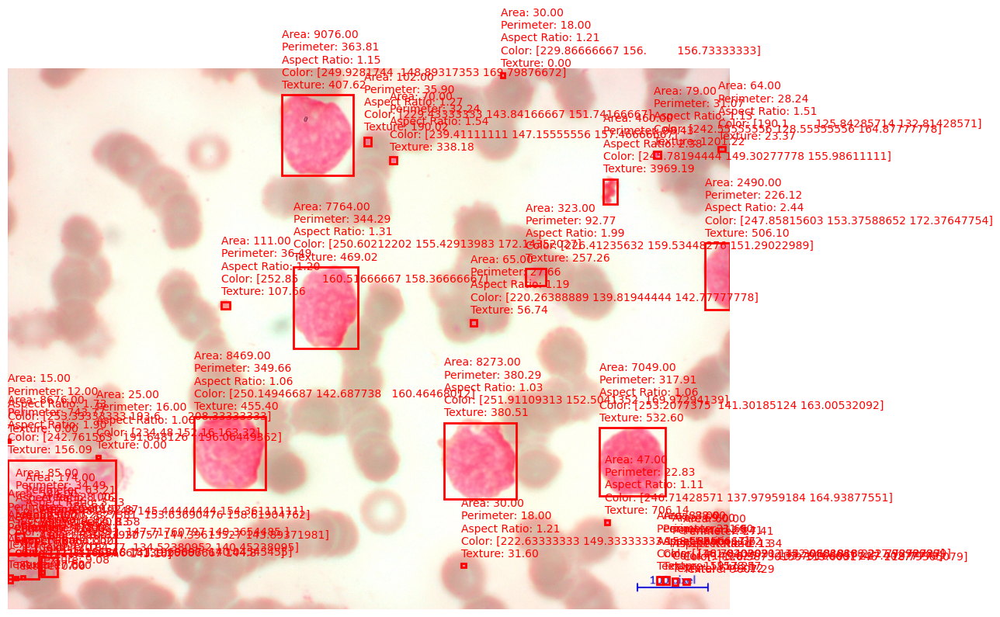

Nombre de cellules malignes : 32


In [21]:
# afficher l'image originale
plt.figure(figsize=(12, 12))
plt.imshow(image_rgb)
plt.axis('off')

# Initialiser le compteur pour les cellules malignes.
malignant_count_thresh = 0

for region, area, perimeter, aspect_ratio, color, texture in zip(regions_thresh, areas, perimeters, aspect_ratios, colors, textures):
        minr, minc, maxr, maxc = region.bbox
        rect = Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
        plt.gca().add_patch(rect)
        plt.text(minc, minr - 10, f'Area: {area:.2f}\nPerimeter: {perimeter:.2f}\nAspect Ratio: {aspect_ratio:.2f}\nColor: {color}\nTexture: {texture:.2f}', color='red')
        
        malignant_count_thresh += 1

plt.show()

print(f"Nombre de cellules malignes : {malignant_count_thresh}")

- Comme indiqué, nous segmentons les cellules et traçons un rectangle autour d'elles.
- Bien que la segmentation ne soit pas parfaite, c'est un bon début.
- Le bruit détecté sera bientôt supprimé.

#### Clustering

Une autre technique, c'est de combiner le k-means

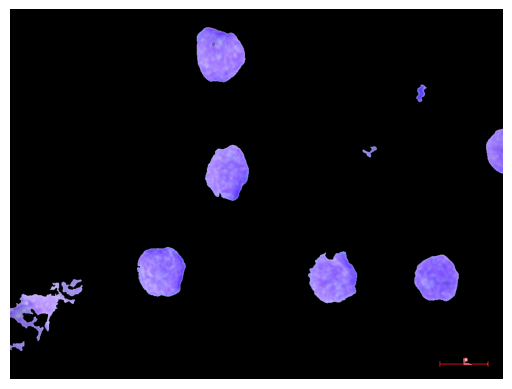

In [39]:
# Charger l'image en RGB
image_rgb = cv2.imread(r"/media/lenovo/3830-5D3C/projet_cv/Blood cell Cancer [ALL]/[Malignant] early Pre-B/Sap_148 (1).jpg")
# Convertir l'image RGB en LAB
image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2LAB)
# Extraire le canal A
canal_A = image_lab[:, :, 1]
# Appliquer le regroupement k-means sur le canal A
canal_a_reshape = canal_A.reshape(-1, 1)
kmeans = KMeans(n_clusters=2, random_state=0).fit(canal_a_reshape)
clustered_a = kmeans.cluster_centers_[kmeans.labels_].reshape(canal_A.shape[0], canal_A.shape[1])
# Appliquer le seuillage binaire
ic = clustered_a.astype(np.uint8)
_, seuil_A = cv2.threshold(ic, 142, 255, cv2.THRESH_BINARY) 
# Combler les trous dans l'image binaire
image_remplie = ndi.binary_fill_holes(seuil_A)
# Supprimer les petits objets et les petits trous
image_nettoyee = morphology.remove_small_objects(image_remplie, min_size=200)
image_nettoyee = morphology.remove_small_holes(image_nettoyee, area_threshold=250)
image_nettoyee = image_nettoyee.astype(np.uint8)
image_sortie = cv2.bitwise_and(image_rgb, image_rgb, mask=image_nettoyee)
# Étiqueter les cellules segmentées
etiquettes = measure.label(image_nettoyee)
# Extraire les propriétés de chaque cellule
regions_kmeans = measure.regionprops(etiquettes)

# Afficher l'image avec les cellules malignes colorées en rouge
plt.imshow(cv2.cvtColor(image_sortie, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [40]:

areas = []
perimeters = []
aspect_ratios = []
colors = []
textures = []

for region in regions_kmeans:
    areas.append(region.area)
    perimeters.append(region.perimeter)
    aspect_ratios.append(region.major_axis_length / region.minor_axis_length)

    minr, minc, maxr, maxc = region.bbox
    cell = image_sortie[minr:maxr, minc:maxc]
    colors.append(np.mean(cell, axis=(0, 1)))

    cell_gray = rgb2gray(cell)
    cell_gray_ubyte = img_as_ubyte(cell_gray)
    
    glcm = graycomatrix(cell_gray_ubyte, [5], [0], 256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    textures.append(contrast)


In [41]:
print("Areas: ", areas)
print("Perimeters: ", perimeters)
print("Aspect Ratios: ", aspect_ratios)
print("Colors: ", colors)
print("Textures: ", textures)

Areas:  [8932.0, 433.0, 2421.0, 7521.0, 252.0, 8248.0, 7982.0, 6897.0, 820.0, 4905.0, 309.0, 351.0]
Perimeters:  [363.3624817342638, 101.49747468305833, 223.67514421272202, 358.5340546095176, 98.32590180780451, 364.048773235279, 389.1614716074871, 317.8061325481598, 215.7228714274745, 806.494516090228, 102.76955262170046, 265.97056274847716]
Aspect Ratios:  [1.1516062932804831, 2.4080430334171754, 2.445592752833926, 1.300940714464164, 1.8779742459665985, 1.06559739176744, 1.0353524618201542, 1.0629320264899782, 1.3004441383284187, 1.5780959200497169, 2.072519989073168, 7.2522825155760255]
Colors:  [array([195.73927393,  98.5714782 , 123.06644085]), array([142.23544974,  57.63756614,  67.68518519]), array([184.57511521,  91.39109063, 114.46789555]), array([180.87912088,  90.87940508, 111.5057787 ]), array([84.79275362, 49.70434783, 52.62318841]), array([201.13774873,  98.19936557, 119.97529559]), array([184.00608206,  92.01007625, 112.97076979]), array([195.64813985,  86.2925818 , 110.7

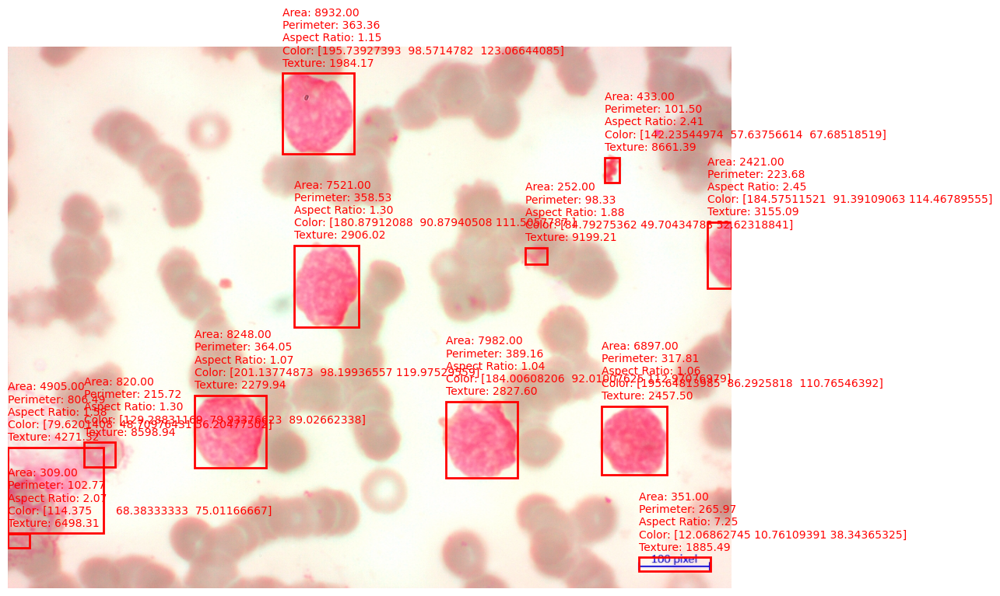

Nombre de cellules malignes : 12


In [45]:
plt.figure(figsize=(12, 12))
plt.imshow(image_rgb)
plt.axis('off')

malignant_count_kmeans = 0

for region, area, perimeter, aspect_ratio, color, texture in zip(regions_kmeans, areas, perimeters, aspect_ratios, colors, textures):
        minr, minc, maxr, maxc = region.bbox
        rect = Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
        plt.gca().add_patch(rect)
        plt.text(minc, minr - 10, f'Area: {area:.2f}\nPerimeter: {perimeter:.2f}\nAspect Ratio: {aspect_ratio:.2f}\nColor: {color}\nTexture: {texture:.2f}', color='red')
        
        malignant_count_kmeans += 1

plt.show()

print(f"Nombre de cellules malignes : {malignant_count_kmeans}")

In [46]:
data = [
    {'technique': 'thresh', 'count': malignant_count_thresh},
    {'technique': 'k-means', 'count': malignant_count_kmeans},
]

df_cells_counted = pd.DataFrame(data)
print(df_cells_counted)

  technique  count
0    thresh     32
1   k-means     12


Nous pourrions dire que le regroupement K-means fonctionne mieux avec le seuillage, 
- Il ne détecte pas beaucoup de bruit.
- Nous allons donc l'utiliser pour notre segmentation.

## functions utilitaires

In [47]:
def kmeans_extract_cell_properties(image_rgb, k=2, threshold_value=142):
    """
    PARAMETRES
    - image_rgb : Image RGB des cellules
    - k : Nombre de clusters pour le regroupement K-means
    - threshold_value : Valeur de seuil pour le seuillage binaire
    """
    # Convertir l'image RGB à l'espace colorimétrique LAB
    image_lab = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2LAB)
    l,a,b = cv2.split(image_lab)                         
        
    # Appliquer le regroupement K-means sur le canal A
    a_reshaped = a.reshape(-1, 1)
    kmeans = KMeans(n_clusters=k, random_state=0).fit(a_reshaped)
    clustered_a = kmeans.cluster_centers_[kmeans.labels_].reshape(a.shape[0], a.shape[1])

    # Appliquer le seuillage binaire au canal A regroupé
    ic = clustered_a.astype(np.uint8)
    _, thresholded_a = cv2.threshold(ic, threshold_value, 255, cv2.THRESH_BINARY)

    # Combler les trous dans l'image binaire
    filled_image = ndi.binary_fill_holes(thresholded_a)

    # Supprimer les petits objets et les petits trous
    cleaned_image = morphology.remove_small_objects(filled_image, min_size=200)
    cleaned_image = morphology.remove_small_holes(cleaned_image, area_threshold=250)
    cleaned_image = cleaned_image.astype(np.uint8)

    # Appliquer la segmentation watershed
    distance = ndi.distance_transform_edt(cleaned_image)
    coords = peak_local_max(distance, min_distance=10, labels=cleaned_image)
    mask = np.zeros(distance.shape, dtype=bool)
    mask[tuple(coords.T)] = True
    markers, _ = ndi.label(mask)
    labels = watershed(-distance, markers, mask=cleaned_image)

    # Extraire les propriétés de chaque cellule
    regions = measure.regionprops(labels)
    return regions, labels

Les caractéristiques que nous allons extraire sont :
- **Aire** : L'aire de la cellule.
- **Périmètre** : Le périmètre de la cellule.
- **Longueur de l'axe majeur** : La longueur de l'axe majeur de la cellule.
- **Longueur de l'axe mineur** : La longueur de l'axe mineur de la cellule.
- **Rapport d'aspect** : Le rapport de la longueur de l'axe majeur à la longueur de l'axe mineur de la cellule.
- **Solidité** : Le rapport de l'aire de la cellule à l'aire de l'enveloppe convexe de la cellule.
- **Diamètre équivalent** : Le diamètre d'un cercle ayant la même aire que la cellule.
- **Étendue** : Le rapport de l'aire de la cellule à l'aire de la boîte englobante de la cellule.
- **Excentricité** : L'excentricité de la cellule.
- **Orientation** : L'angle entre l'axe majeur de la cellule et l'axe x.
- **Intensité moyenne** : L'intensité moyenne de la cellule.
- **Écart-type de l'intensité** : L'écart-type de l'intensité de la cellule.
- **Intensité médiane** : L'intensité médiane de la cellule.
- **Contraste** : Le contraste de la cellule.
- **Corrélation** : La corrélation de la cellule.
- **Énergie** : L'énergie de la cellule.
- **Centroïde** : Les coordonnées du centroïde de la cellule.
- **Boîte englobante** : Les coordonnées de la boîte englobante de la cellule.
- **Aire convexe** : L'aire de l'enveloppe convexe de la cellule.
- **Circularité** : Le rapport du périmètre de la cellule au périmètre d'un cercle ayant la même aire que la cellule.
- **Couleur** : La couleur de la cellule.

In [48]:
def extract_features(region,image_rgb):
    # Morphologique 
    solidity = region.solidity
    eccentricity = region.eccentricity
    orientation = region.orientation
    equivalent_diameter = region.equivalent_diameter
    
    # Couleur 
    minr, minc, maxr, maxc = region.bbox
    cell = image_rgb[minr:maxr, minc:maxc]
    color = np.mean(cell, axis=(0, 1))
    
    # Texture 
    cell_gray = rgb2gray(cell)
    cell_gray_ubyte = img_as_ubyte(cell_gray)
    glcm = graycomatrix(cell_gray_ubyte, [5], [0], 256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    
    # Intensité 
    mean_intensity = np.mean(cell)
    median_intensity = np.median(cell)
    std_intensity = np.std(cell)
    correlation = graycoprops(glcm, 'correlation')[0, 0]
    energy = graycoprops(glcm, 'energy')[0, 0]
    
    # Autres 
    centroid = region.centroid
    convex_area = region.convex_area
    bbox_area = region.bbox_area
    bbox = region.bbox
    extent = region.extent
    # filled_area = region.filled_area
    circulatie = region.perimeter ** 2 / (4 * np.pi * region.area)
    
    return {
        "solidity": solidity,
        "eccentricity": eccentricity,
        "orientation": orientation,
        "equivalent_diameter": equivalent_diameter,
        "color": color,
        "contrast": contrast,
        "mean_intensity": mean_intensity,
        "median_intensity": median_intensity,
        "std_intensity": std_intensity,
        "correlation": correlation,
        "energy": energy,
        "centroid": centroid,
        "convex_area": convex_area,
        "bbox_area": bbox_area,
        "extent": extent,
        "circulatie": circulatie,
    }

In [49]:
def process_images(rgb_images, images_label, labeled_features,display_images=False):
    for index, (image_rgb, image_label) in enumerate(zip(rgb_images, images_label)):
        # extraire les régions
        regions,output_image= kmeans_extract_cell_properties(image_rgb)
        
        # calculer le nombres de cellules segmentées dans chaque image
        count_cells_in_image = len(regions)

        # calculer le perimtre moyenne des cellules segmentées dans chaque image
        avg_perimeter = np.mean([region.perimeter for region in regions])

        # calculer le std du perimtre des cellules segmentées dans chaque image
        std_perimeter = np.std([region.perimeter for region in regions])
        
        features = []
        
        for region in regions:
            region_features = extract_features(region, image_rgb)
            region_features['cells_in_image'] = count_cells_in_image
            features.append(region_features)
        
        if display_images:
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image)
            plt.title(image_label)
            plt.axis('off')
        
        # tracer un rectangle pour chaque cellule
        for region, region_features in zip(regions, features):
            if region.perimeter <= avg_perimeter + std_perimeter : # pour minimiser le bruit
                minr, minc, maxr, maxc = region.bbox
                rect = Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
                plt.gca().add_patch(rect)
                floored_color = tuple(map(int, region_features["color"]))
                
                # plt.text(minc, minr - 10, f'Area: {region.area:.2f}\nPerimeter: {region.perimeter:.2f}\nAspect Ratio: {region.major_axis_length / region.minor_axis_length:.2f}\nColor: {floored_color}\nTexture: {region_features["contrast"]:.2f}', color='red')
                region_features["area"] = region.area
                region_features["perimeter"] = region.perimeter
                region_features["aspect_ratio"] = region.major_axis_length / (region.minor_axis_length + 1e-10)
                region_features["label"] = image_label
                # ajouter l'index de l'image
                region_features["image_index"] = index
                labeled_features.append(region_features)
            
        # if display_images:
        #     plt.axis('off')
        #     plt.show()


## Préparation pour l'entrainement

- enregistre les images ségmentées

In [ ]:
# Initialisation du compteur
compteur = 0

# Pour chaque image dans la liste d'entraînement
for image_path in train_list:
    
    # Charger l'image
    image = cv2.imread(image_path)    
    # Redimensionner l'image à la taille spécifiée
    image = cv2.resize(image, (224, 224))
    # Extraire l'étiquette de l'image
    etiquette = image_path.split(os.path.sep)[3]
    
    #-------- Segmentation ---------
    
    # Convertir l'image en RVB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Convertir l'image en espace de couleur LAB
    image_lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)        
    # Séparer les canaux LAB
    l, a, b = cv2.split(image_lab)                         
    # Réorganiser le canal A pour le clustering
    a_reshape = a.reshape(a.shape[0] * a.shape[1], 1)
    # Appliquer le regroupement K-means
    kmeans = KMeans(n_clusters=2, random_state=0).fit(a_reshape)  
    p2s = kmeans.cluster_centers_[kmeans.labels_]
    ic = p2s.reshape(a.shape[0], a.shape[1])
    ic = ic.astype(np.uint8)
    # Appliquer un seuillage binaire
    r, t = cv2.threshold(ic, 142, 255, cv2.THRESH_BINARY) 
    # Combler les trous dans l'image binaire
    fh = ndi.binary_fill_holes(t)                      
    # Supprimer les petits objets
    m1 = morphology.remove_small_objects(fh, min_size=200)
    # Supprimer les petits trous
    m2 = morphology.remove_small_holes(m1, area_threshold=250)
    m2 = m2.astype(np.uint8)  
    # Appliquer un masque à l'image d'entrée
    out = cv2.bitwise_and(image, image, mask=m2)
    
    # Déterminer le chemin de sauvegarde en fonction de l'étiquette
    if (etiquette == "Benign"):
        chemin_sauvegarde = ('../data/segmented_train/benign/' + etiquette + str(compteur) + '.jpg') 
    if (etiquette == "[Malignant] Pre-B"):
        chemin_sauvegarde = ('../data/segmented_train/PreB/' + etiquette + str(compteur) + '.jpg')  
    if (etiquette == "[Malignant] Pro-B"):
        chemin_sauvegarde = ('../data/segmented_train/ProB/' + etiquette + str(compteur) + '.jpg') 
    if (etiquette == "[Malignant] early Pre-B"):
        chemin_sauvegarde = ('../data/segmented_train/EarlyPreB/' + etiquette + str(compteur) + '.jpg')
    
    # Incrémenter le compteur
    compteur += 1
    # Convertir l'image en format BGR avant de l'enregistrer
    out = cv2.cvtColor(out, cv2.COLOR_RGB2BGR)
    # Enregistrer l'image segmentée
    cv2.imwrite(chemin_sauvegarde, out)


- la meme chose pour les images de test

In [ ]:
p=0
for img in test_list:
    
    i= cv2.imread(img)    
    i= cv2.resize(i,(224,224))
    label= img.split(os.path.sep)[3]
    
    #-------- Segmentation --------- 
    i= cv2.cvtColor(i, cv2.COLOR_BGR2RGB)
    i_lab = cv2.cvtColor(i, cv2.COLOR_RGB2LAB)        
    l,a,b = cv2.split(i_lab)                         
    i2 = a.reshape(a.shape[0]*a.shape[1],1)
    km= KMeans(n_clusters=2, random_state=0).fit(i2)  
    p2s= km.cluster_centers_[km.labels_]
    ic= p2s.reshape(a.shape[0],a.shape[1])
    ic = ic.astype(np.uint8)
    r,t = cv2.threshold(ic,142,255 ,cv2.THRESH_BINARY) 
    fh = ndi.binary_fill_holes(t)                      
    m1 = morphology.remove_small_objects(fh, 200)
    m2 = morphology.remove_small_holes(m1,250)
    m2 = m2.astype(np.uint8)  
    out = cv2.bitwise_and(i, i, mask=m2)
    
    if (label=="Benign"):
        b= ('../data/segmented_test/benign/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] Pre-B"):
        b= ('../data/segmented_test/PreB/'+label+str(p)+'.jpg')  
    if (label=="[Malignant] Pro-B"):
        b= ('../data/segmented_test/ProB/'+label+str(p)+'.jpg') 
    if (label=="[Malignant] early Pre-B"):
        b= ('../data/segmented_test/EarlyPreB/'+label+str(p)+'.jpg')
    p+=1
    out= cv2.cvtColor(out, cv2.COLOR_RGB2BGR)
    cv2.imwrite(b,out)

Afficher quelque exemples d'images avec les étapes de segmentation

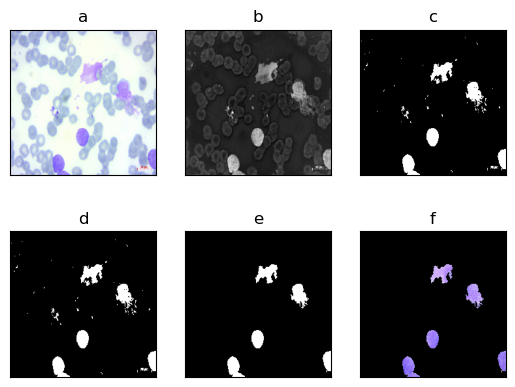

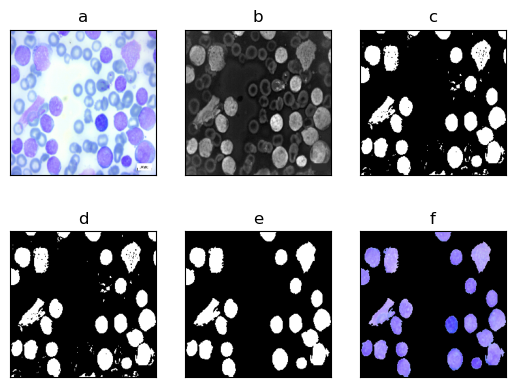

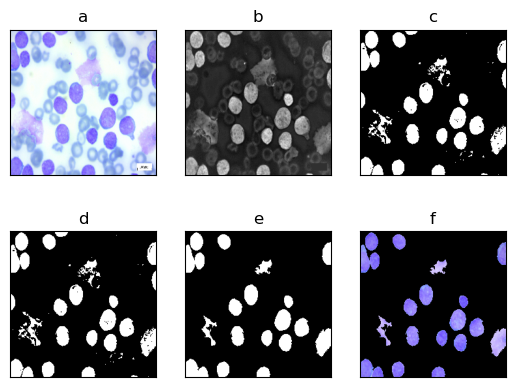

In [50]:
# Nombre d'images à traiter
nb_images = 3

# Listes pour stocker les différentes images et résultats
images_originales = []
images_canal_a = []
images_cluster = []
images_seuillage = []
images_morphologie = []
images_segmentees = []

# Sélection aléatoire des images
images_random = random.sample(data_list, nb_images)

# Parcourir les n premières images de la liste
for image_path in images_random:
    # Charger l'image
    image = cv2.imread(image_path)    
    # Convertir l'image en RVB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Redimensionner l'image
    image = cv2.resize(image, (224, 224))
    # Ajouter l'image originale à la liste
    images_originales.append(image)
    # Convertir l'image en espace de couleur LAB
    image_lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    # Séparer les canaux LAB
    l, a, b = cv2.split(image_lab)
    # Ajouter le canal A à la liste
    images_canal_a.append(a)
    # Réorganiser le canal A pour le clustering
    a_reshape = a.reshape(a.shape[0] * a.shape[1], 1)
    # Appliquer le regroupement K-means
    kmeans = KMeans(n_clusters=2, random_state=0).fit(a_reshape)
    # Récupérer les centres de clusters
    p2s = kmeans.cluster_centers_[kmeans.labels_]
    # Réorganiser les clusters
    ic = p2s.reshape(a.shape[0], a.shape[1])
    # Convertir en type de données uint8
    ic = ic.astype(np.uint8)
    # Ajouter l'image du cluster à la liste
    images_cluster.append(ic)
    # Appliquer un seuillage binaire
    r, t = cv2.threshold(ic, 142, 255, cv2.THRESH_BINARY)
    # Ajouter l'image seuillée à la liste
    images_seuillage.append(t)
    # Combler les trous dans l'image binaire
    fh = ndi.binary_fill_holes(t)
    # Supprimer les petits objets
    m1 = morphology.remove_small_objects(fh, min_size=200)
    # Supprimer les petits trous
    m2 = morphology.remove_small_holes(m1, area_threshold=250)
    # Convertir en type de données uint8
    m2 = m2.astype(np.uint8)
    # Ajouter l'image après morphologie à la liste
    images_morphologie.append(m2)
    # Appliquer un masque à l'image originale
    out = cv2.bitwise_and(image, image, mask=m2)
    # Ajouter l'image segmentée à la liste
    images_segmentees.append(out)

# Afficher les images
for j in range(nb_images):    
    for t in range(1):
        plt.subplot(2, 3, 1 + t), plt.imshow(images_originales[j])
        plt.title('a'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 2 + t), plt.imshow(images_canal_a[j], 'gray')
        plt.title('b'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 3 + t), plt.imshow(images_cluster[j], 'gray')
        plt.title('c'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 4 + t), plt.imshow(images_seuillage[j], 'gray')
        plt.title('d'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 5 + t), plt.imshow(images_morphologie[j], 'gray')
        plt.title('e'), plt.xticks([]), plt.yticks([])
        plt.subplot(2, 3, 6 + t), plt.imshow(images_segmentees[j])
        plt.title('f'), plt.xticks([]), plt.yticks([])
    plt.show()      

Création des DataFrames

In [51]:
segmented_data_path = r'/media/lenovo/3830-5D3C/Blood-cell-detection/data/segmented_train'
segmented_data_list_filenames = (sorted(list(paths.list_images(segmented_data_path))))
random.shuffle(segmented_data_list_filenames)
segmented_data_list_labels = []

for line in segmented_data_list_filenames:
    segmented_data_list_labels.append(line.split(os.path.sep)[7])

I_series = pd.Series(segmented_data_list_filenames, name='filenames')
L_series = pd.Series(segmented_data_list_labels, name='labels')
segmented_train_df = pd.concat( [I_series, L_series], axis=1) 

print('-- image segmentées --')
print(segmented_train_df.head())

print('\n')
print("-- Nombre de chaque cetegorie --")
a = segmented_train_df['labels'].value_counts()      
a

-- image segmentées --
                                           filenames     labels
0  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
1  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
2  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       PreB
3  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
4  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       ProB


-- Nombre de chaque cetegorie --


labels
EarlyPreB    774
PreB         766
ProB         638
benign       415
Name: count, dtype: int64

In [52]:
segmented_data_path = r'/media/lenovo/3830-5D3C/Blood-cell-detection/data/segmented_test'
segmented_data_list_filenames = (sorted(list(paths.list_images(segmented_data_path))))
random.shuffle(segmented_data_list_filenames)
segmented_data_list_labels = []

for line in segmented_data_list_filenames:
    segmented_data_list_labels.append(line.split(os.path.sep)[7])

I_series = pd.Series(segmented_data_list_filenames, name='filenames')
L_series = pd.Series(segmented_data_list_labels, name='labels')
segmented_test_df = pd.concat( [I_series, L_series], axis=1) 

print('-- image segmentées --')
print(segmented_test_df.head())

print('\n')
print("-- Nombre de chaque cetegorie --")
a = segmented_test_df['labels'].value_counts()      
a

-- image segmentées --
                                           filenames     labels
0  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       PreB
1  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
2  /media/lenovo/3830-5D3C/Blood-cell-detection/d...       PreB
3  /media/lenovo/3830-5D3C/Blood-cell-detection/d...  EarlyPreB
4  /media/lenovo/3830-5D3C/Blood-cell-detection/d...     benign


-- Nombre de chaque cetegorie --


labels
EarlyPreB    205
PreB         189
ProB         158
benign        97
Name: count, dtype: int64

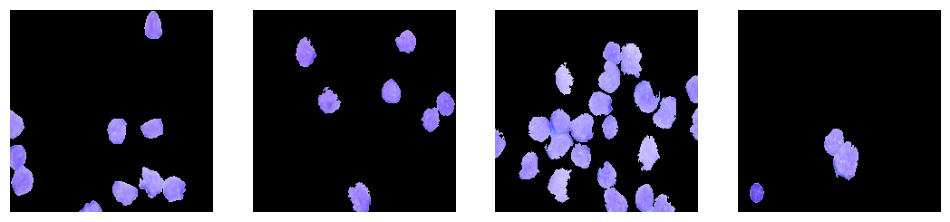

In [53]:
fig = plt.figure(figsize=(12, 12))  
for index, img in enumerate(segmented_train_df['filenames'][:4]):
    i = cv2.imread(img)
    plt.subplot(1, 4, index+1) 
    plt.imshow(cv2.cvtColor(i, cv2.COLOR_BGR2RGB)) 
    plt.axis('off')

plt.show()

## Extraire les caractéristiques

Exemples des images avec les caractéristiques extraites

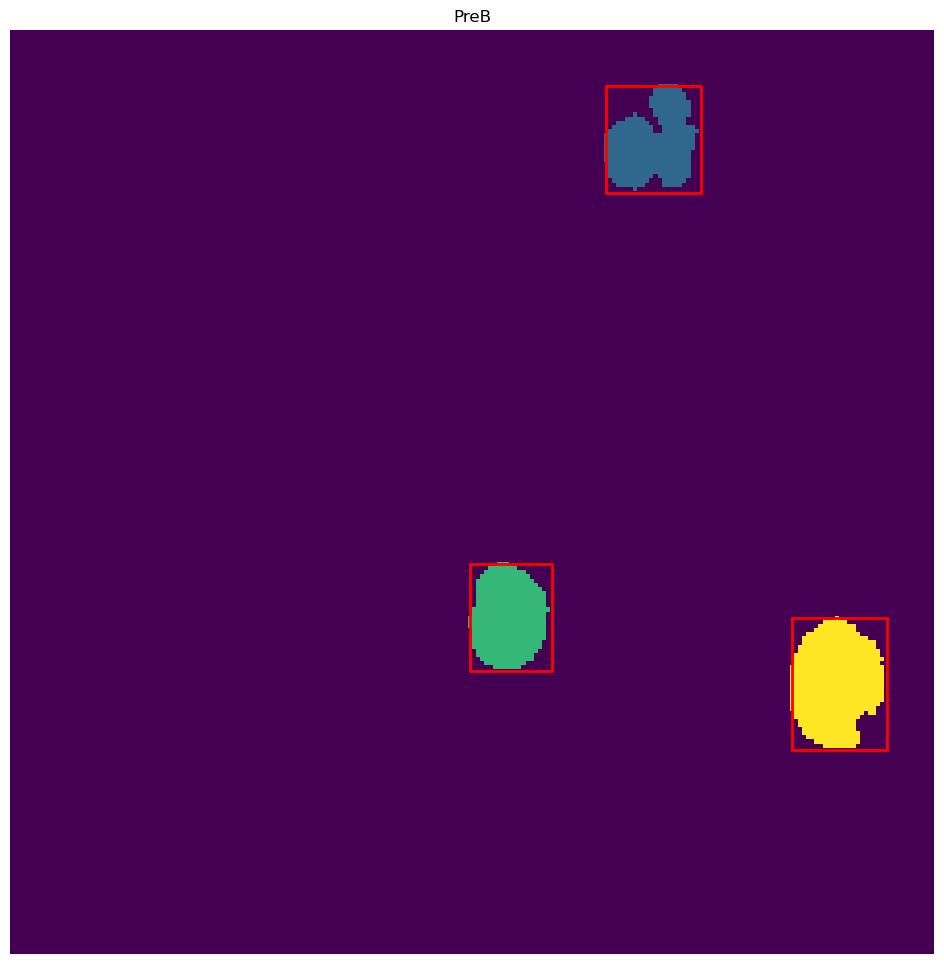

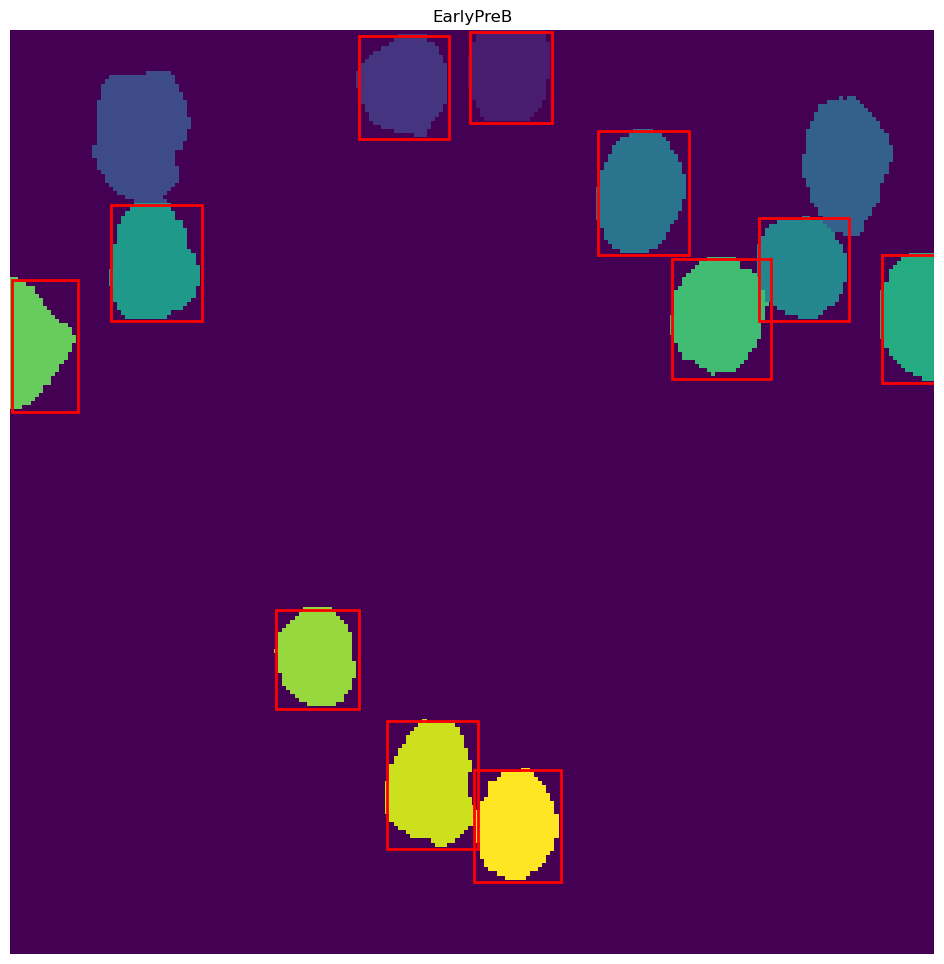

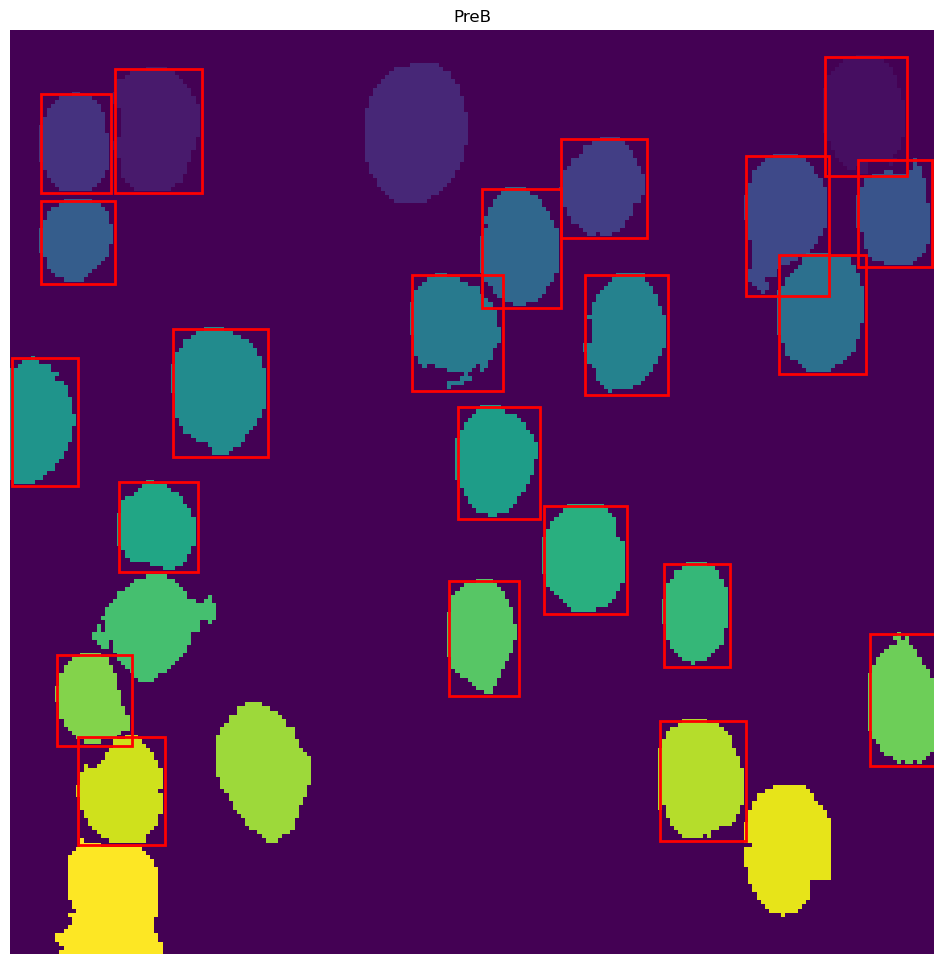

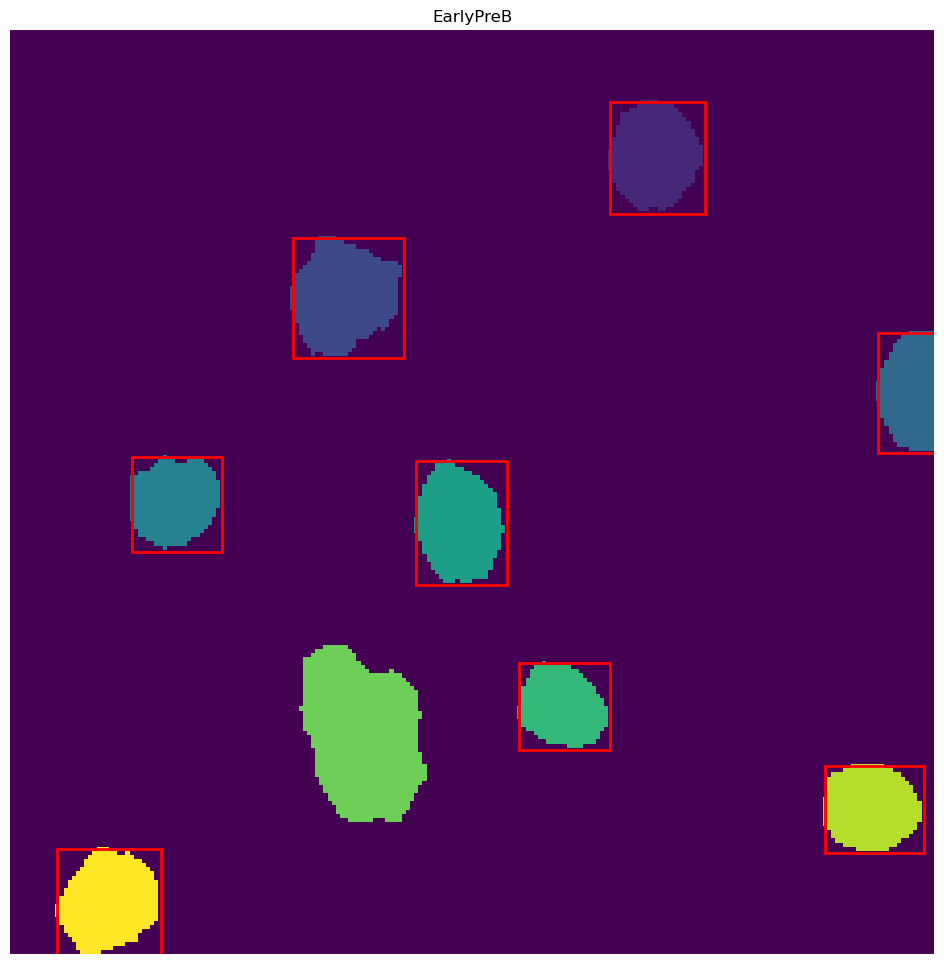

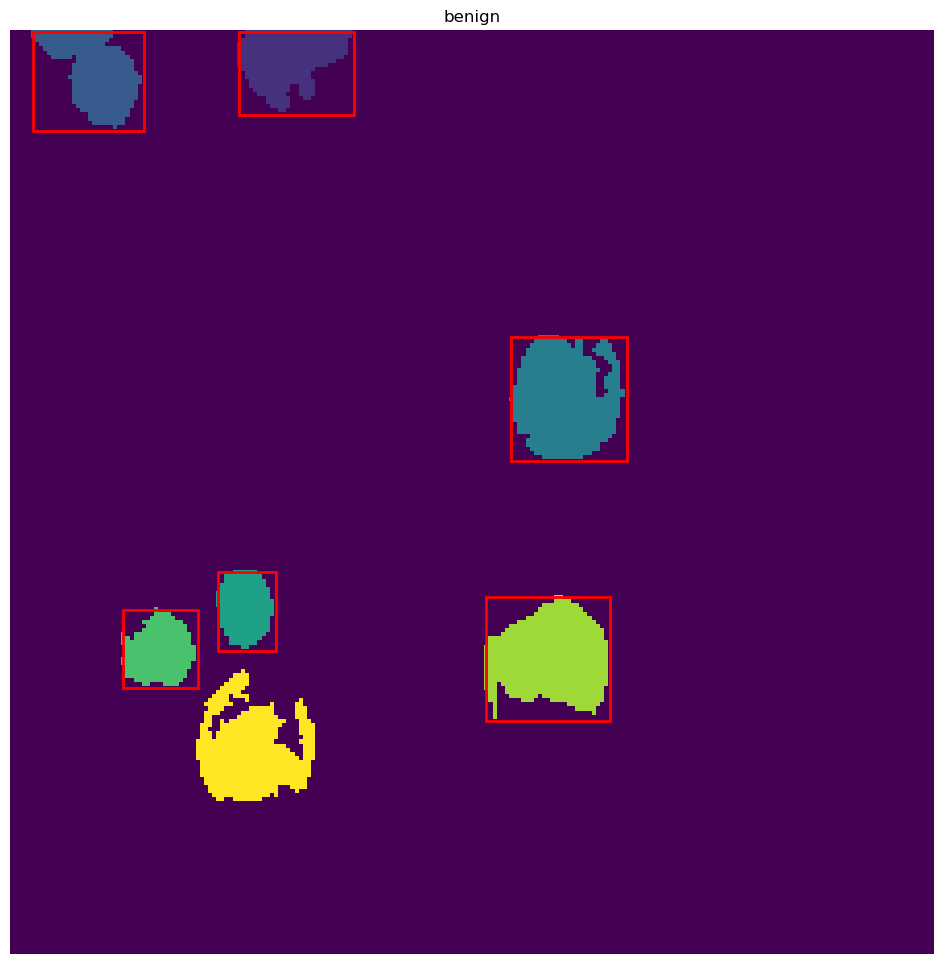

In [54]:
labeled_features_example = []
process_images([cv2.imread(img) for img in segmented_test_df['filenames'][:5]], segmented_test_df['labels'][:5], labeled_features_example,True)

Maintenant, extrayons les caractéristiques des images et stockons-les dans un DataFrame.

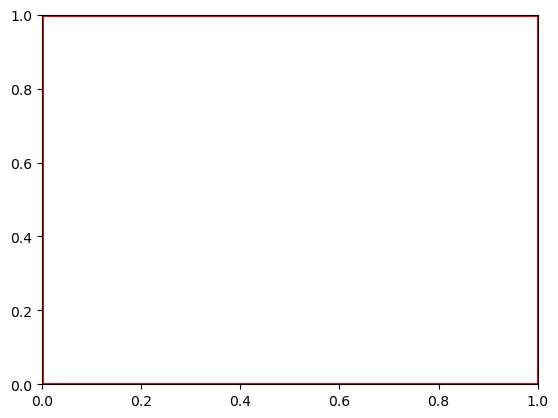

In [55]:
labeled_features_train = []
process_images([cv2.imread(img) for img in segmented_train_df['filenames']], segmented_train_df['labels'], labeled_features_train)

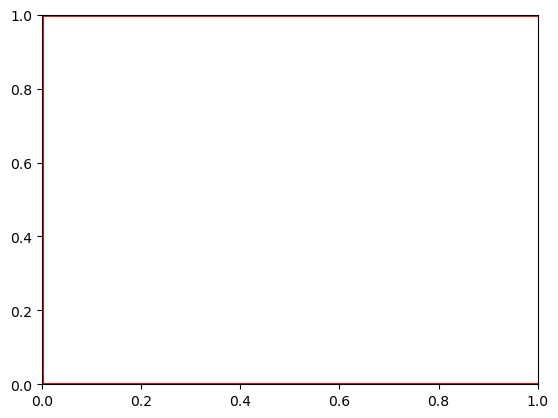

In [56]:
labeled_features_test = []
process_images([cv2.imread(img) for img in segmented_test_df['filenames']], segmented_test_df['labels'], labeled_features_test)

In [57]:
train_df = pd.DataFrame(labeled_features_train)
train_df.head()

,solidity,eccentricity,orientation,equivalent_diameter,color,contrast,mean_intensity,median_intensity,std_intensity,correlation,...,convex_area,bbox_area,extent,circulatie,cells_in_image,area,perimeter,aspect_ratio,label,image_index
0,0.960825,0.793684,0.044306,24.358358,"[184.55806451612904, 100.97903225806452, 121.0...",7547.079570,135.530645,150.0,87.215779,-0.029832,...,485.0,620.0,0.751613,1.186509,10,466.0,83.355339,1.643843,EarlyPreB,0
1,0.956989,0.845430,0.039589,21.290216,"[167.4185606060606, 100.26704545454545, 114.36...",8012.038567,127.349747,152.0,94.838207,0.360883,...,372.0,528.0,0.674242,1.442067,10,356.0,80.319805,1.872356,EarlyPreB,0
2,0.954338,0.592297,-1.195094,23.069767,"[193.41454545454545, 109.79636363636364, 127.4...",6864.825000,143.553333,158.5,89.672265,0.223534,...,438.0,550.0,0.760000,1.132050,10,418.0,77.112698,1.241127,EarlyPreB,0
3,0.962376,0.700666,-0.100369,24.875579,"[200.17532467532467, 117.17857142857143, 131.5...",7543.483193,149.639610,161.0,86.960893,-0.043535,...,505.0,616.0,0.788961,1.099405,10,486.0,81.941125,1.401563,EarlyPreB,0
4,0.961364,0.748468,-0.045975,23.207333,"[219.33928571428572, 113.46825396825396, 131.0...",3599.425824,154.603836,145.0,72.259296,-0.100936,...,440.0,504.0,0.839286,1.187686,10,423.0,79.455844,1.507907,EarlyPreB,0


In [58]:
# Diviser la couleur en R, G, B (rouge, vert, bleu).
train_df['R'] = train_df['color'].apply(lambda x: x[0])
train_df['G'] = train_df['color'].apply(lambda x: x[1])
train_df['B'] = train_df['color'].apply(lambda x: x[2])
train_df = train_df.drop('color', axis=1)

# Diviser centroid en x, y
train_df['centroid_x'] = train_df['centroid'].apply(lambda x: x[1])
train_df['centroid_y'] = train_df['centroid'].apply(lambda x: x[0])
train_df = train_df.drop('centroid', axis=1)

In [59]:
train_df.head()

,solidity,eccentricity,orientation,equivalent_diameter,contrast,mean_intensity,median_intensity,std_intensity,correlation,energy,...,area,perimeter,aspect_ratio,label,image_index,R,G,B,centroid_x,centroid_y
0,0.960825,0.793684,0.044306,24.358358,7547.079570,135.530645,150.0,87.215779,-0.029832,0.060807,...,466.0,83.355339,1.643843,EarlyPreB,0,184.558065,100.979032,121.054839,157.654506,18.641631
1,0.956989,0.845430,0.039589,21.290216,8012.038567,127.349747,152.0,94.838207,0.360883,0.185833,...,356.0,80.319805,1.872356,EarlyPreB,0,167.418561,100.267045,114.363636,5.825843,127.747191
2,0.954338,0.592297,-1.195094,23.069767,6864.825000,143.553333,158.5,89.672265,0.223534,0.095129,...,418.0,77.112698,1.241127,EarlyPreB,0,193.414545,109.796364,127.449091,157.002392,131.497608
3,0.962376,0.700666,-0.100369,24.875579,7543.483193,149.639610,161.0,86.960893,-0.043535,0.051331,...,486.0,81.941125,1.401563,EarlyPreB,0,200.175325,117.178571,131.564935,117.751029,134.094650
4,0.961364,0.748468,-0.045975,23.207333,3599.425824,154.603836,145.0,72.259296,-0.100936,0.045682,...,423.0,79.455844,1.507907,EarlyPreB,0,219.339286,113.468254,131.003968,7.862884,162.777778


In [60]:
# grouper par image_index  et former un vecteur de caractéristiques pour chaque image
train_df_grouped = train_df.groupby('image_index').agg({
    'solidity': ['mean', 'std'],
    'eccentricity': ['mean', 'std'],
    'orientation': ['mean', 'std'],
    'equivalent_diameter': ['mean', 'std'],
    'contrast': ['mean', 'std'],
    'mean_intensity': ['mean', 'std'],
    'median_intensity': ['mean', 'std'],
    'std_intensity': ['mean', 'std'],
    'correlation': ['mean', 'std'],
    'energy': ['mean', 'std'],
    'convex_area': ['mean', 'std'],
    'bbox_area': ['mean', 'std'],
    'extent': ['mean', 'std'],
    'circulatie': ['mean', 'std'],
    'cells_in_image': 'first',
    'area': ['mean', 'std'],
    'perimeter':  ['mean', 'std'],
    'aspect_ratio':  ['mean', 'std'],
    'R':  ['mean', 'std'],
    'G':  ['mean', 'std'],
    'B':  ['mean', 'std'],
    'centroid_x':  ['mean', 'std'],
    'centroid_y':  ['mean', 'std'],
    'label': 'first',
    })

train_df_grouped

solidity           eccentricity           orientation            \
                 mean       std         mean       std        mean       std   
image_index                                                                    
0            0.952085  0.012728     0.695799  0.120603   -0.215611  0.723074   
1            0.939048  0.021763     0.639117  0.126780    0.040144  0.149734   
2            0.929103  0.029686     0.688316  0.141842    0.084919  0.439153   
3            0.964069  0.004361     0.723957  0.042199   -0.192498  0.268917   
4            0.941576  0.003645     0.628813  0.104890    0.184653  0.211653   
...               ...       ...          ...       ...         ...       ...   
2588         0.942768  0.030133     0.633643  0.125404   -0.024961  0.622210   
2589         0.957259  0.009022     0.580145  0.123294   -0.135807  0.271773   
2590         0.880036  0.083182     0.712057  0.133648    0.023592  0.700992   
2591         0.926261  0.046764     0.577583  0.182855    0.127526  0.639010   
2592         0.962040  0.008267     0.500500  0.135750    0.027733  0.303805   

            equivalent_diameter               contrast               ...  \
                           mean       std         mean          std  ...   
image_index                                                          ...   
0                     23.668432  3.366688  6784.275103  1295.686890  ...   
1                     23.538883  1.278719  7215.845212   951.276667  ...   
2                     24.474922  3.090184  8471.701975  2439.565492  ...   
3                     21.389628  4.272263  5777.204894    56.822258  ...   
4                     21.880071  0.029096  9288.574626   895.498598  ...   
...                         ...       ...          ...          ...  ...   
2588                  22.095135  5.322696  7350.067577  3082.872449  ...   
2589                  25.250233  1.555530  6359.182446  1059.531763  ...   
2590                  20.227304  2.141658  9985.465136  3144.014605  ...   
2591                  29.989280  3.163950  6810.012278  2691.248010  ...   
2592                  25.754925  2.270548  4990.095079   375.385103  ...   

                     R           G                      B             \
                   std        mean        std        mean        std   
image_index                                                            
0            20.231684  105.137974  10.510399  120.456398  12.179269   
1            10.058479   92.797699   6.519529  113.357439   6.143669   
2            16.814070  114.407465   9.024260  124.403710   8.616225   
3            18.942293   97.102936  41.250172  115.002746  37.082796   
4             3.977413  128.520718  17.143383  164.320913  16.689697   
...                ...         ...        ...         ...        ...   
2588         17.896201  101.419065  16.127609  110.274053  16.599238   
2589         14.021550   98.585384  10.860153  118.251297  11.227330   
2590         18.635858  103.877190  12.552228  111.865270  13.214569   
2591         16.264018  115.428785   9.479398  130.051228   9.014815   
2592          6.830309  100.854961   9.807599  123.446110   7.498952   

             centroid_x             centroid_y                 label  
                   mean        std        mean        std      first  
image_index                                                           
0             95.080932  69.636162  153.723623  60.953979  EarlyPreB  
1            157.164824  60.391416   80.209625  36.790719  EarlyPreB  
2            107.017517  54.010629  139.250860  50.064088       PreB  
3             62.792852  60.315439  174.202205  39.899050  EarlyPreB  
4            132.172287  15.947225  104.326452  61.269861       ProB  
...                 ...        ...         ...        ...        ...  
2588         116.325803  66.704248  103.971551  60.244890       PreB  
2589          99.237494  41.442771  139.427601  51.609254  EarlyPreB  
2590          56.570913  41.277363  1

In [61]:
train_df_grouped.describe()

solidity              eccentricity               orientation  \
              mean          std         mean          std         mean   
count  2592.000000  2546.000000  2592.000000  2546.000000  2592.000000   
mean      0.935332     0.035202     0.674726     0.112670    -0.014807   
std       0.028757     0.031213     0.055685     0.049969     0.197734   
min       0.723456     0.000000     0.261479     0.000007    -1.039794   
25%       0.926450     0.012910     0.644415     0.081002    -0.115974   
50%       0.943874     0.023925     0.677542     0.109374    -0.012687   
75%       0.953600     0.048987     0.709223     0.140203     0.085916   
max       0.988048     0.299421     0.897996     0.639641     1.503454   

                   equivalent_diameter                   contrast  \
               std                mean          std          mean   
count  2546.000000         2592.000000  2546.000000   2592.000000   
mean      0.408832           22.614078     3.226711   7756.737874   
std       0.237736            2.822878     1.989549   2103.951392   
min       0.000419            9.395153     0.000000   3253.032002   
25%       0.215207           20.990877     1.827005   6246.755072   
50%       0.387804           22.461919     2.827132   7146.762836   
75%       0.571198           23.985706     4.233368   9180.881510   
max       2.100243           49.904474    14.593935  17509.938567   

                     ...            R                         G               \
                std  ...         mean          std         mean          std   
count   2546.000000  ...  2592.000000  2546.000000  2592.000000  2546.000000   
mean    1811.633320  ...   188.703139    15.046148   106.610881    11.696861   
std     1282.701759  ...    10.745224     8.254857    17.638525     5.939137   
min        2.733566  ...   117.604125     0.000746    52.081371     0.003525   
25%     1006.935184  ...   184.429915     9.425833    94.446934     7.764890   
50%     1479.974180  ...   190.582271    13.662695   103.325900    10.867685   
75%     2272.041396  ...   195.466952    19.142994   118.662922    14.524906   
max    13779.203843  ...   236.697181    67.536134   172.329966    49.555674   

                 B                centroid_x                centroid_y  \
              mean          std         mean          std         mean   
count  2592.000000  2546.000000  2592.000000  2546.000000  2592.000000   
mean    127.314584    12.580607   114.773843    55.081376   117.197342   
std      22.973291     6.947304    23.608730    17.280655    25.030403   
min      64.920389     0.117689    23.525694     0.155743    14.906161   
25%     111.703783     8.002818   100.546372    45.721198   101.291477   
50%     118.752304    11.363907   114.320041    58.006444   116.573875   
75%     140.869306    15.692771   129.378229    66.000572   131.626518   
max     201.033670    61.942273   215.846939   139.887482   215.427907   

                    
               std  
count  2546.000000  
mean     56.728612  
std      18.350723  
min       0.103134  
25%      47.307175  
50%      59.526397  
75%      67.846538  
max     124.668044  

[8 rows x 45 columns]

In [62]:
test_df = pd.DataFrame(labeled_features_test)
test_df.head()

,solidity,eccentricity,orientation,equivalent_diameter,color,contrast,mean_intensity,median_intensity,std_intensity,correlation,...,convex_area,bbox_area,extent,circulatie,cells_in_image,area,perimeter,aspect_ratio,label,image_index
0,0.863135,0.653039,-0.668409,22.312254,"[158.87959866220737, 86.13545150501672, 115.44...",8086.596154,120.153846,139.0,94.103437,0.241121,...,453.0,598.0,0.653846,1.934640,3,391.0,97.497475,1.320438,PreB,0
1,0.948403,0.686402,-0.014988,22.169133,"[185.72884615384615, 76.00961538461539, 97.813...",5616.305128,119.850641,118.0,90.195579,0.047244,...,407.0,520.0,0.742308,1.109344,3,386.0,73.355339,1.375095,PreB,0
2,0.935154,0.676643,-0.123283,26.414679,"[183.91983695652175, 87.19836956521739, 108.47...",5259.484375,126.532156,135.0,88.854153,0.256807,...,586.0,736.0,0.744565,1.278767,3,548.0,93.840620,1.358121,PreB,0
3,0.977387,0.500103,-0.188515,22.255116,"[223.7022727272727, 111.34545454545454, 133.19...",3953.312121,156.081061,149.0,76.833627,-0.114886,...,398.0,440.0,0.884091,1.071852,13,389.0,72.384776,1.154780,EarlyPreB,1
4,0.956221,0.445095,-0.184805,22.986831,"[189.68363636363637, 87.12363636363636, 105.13...",5765.825882,127.312727,130.0,89.388558,0.139480,...,434.0,550.0,0.754545,1.105850,13,415.0,75.941125,1.116715,EarlyPreB,1


In [63]:
# Diviser la couleur en R, G, B (rouge, vert, bleu).
test_df['R'] = test_df['color'].apply(lambda x: x[0])
test_df['G'] = test_df['color'].apply(lambda x: x[1])
test_df['B'] = test_df['color'].apply(lambda x: x[2])
test_df = test_df.drop('color', axis=1)

# Diviser centroid en x, y
test_df['centroid_x'] = test_df['centroid'].apply(lambda x: x[1])
test_df['centroid_y'] = test_df['centroid'].apply(lambda x: x[0])
test_df = test_df.drop('centroid', axis=1)

In [64]:
test_df.head()

,solidity,eccentricity,orientation,equivalent_diameter,contrast,mean_intensity,median_intensity,std_intensity,correlation,energy,...,area,perimeter,aspect_ratio,label,image_index,R,G,B,centroid_x,centroid_y
0,0.863135,0.653039,-0.668409,22.312254,8086.596154,120.153846,139.0,94.103437,0.241121,0.151649,...,391.0,97.497475,1.320438,PreB,0,158.879599,86.135452,115.446488,155.386189,26.887468
1,0.948403,0.686402,-0.014988,22.169133,5616.305128,119.850641,118.0,90.195579,0.047244,0.068730,...,386.0,73.355339,1.375095,PreB,0,185.728846,76.009615,97.813462,120.235751,141.976684
2,0.935154,0.676643,-0.123283,26.414679,5259.484375,126.532156,135.0,88.854153,0.256807,0.094351,...,548.0,93.840620,1.358121,PreB,0,183.919837,87.198370,108.478261,199.609489,157.868613
3,0.977387,0.500103,-0.188515,22.255116,3953.312121,156.081061,149.0,76.833627,-0.114886,0.052179,...,389.0,72.384776,1.154780,EarlyPreB,1,223.702273,111.345455,133.195455,120.578406,10.028278
4,0.956221,0.445095,-0.184805,22.986831,5765.825882,127.312727,130.0,89.388558,0.139480,0.083703,...,415.0,75.941125,1.116715,EarlyPreB,1,189.683636,87.123636,105.130909,95.137349,12.853012


In [65]:
# grouper par image_index  et former un vecteur de caractéristiques pour chaque image
test_df_grouped = test_df.groupby('image_index').agg({
    'solidity': ['mean', 'std'],
    'eccentricity': ['mean', 'std'],
    'orientation': ['mean', 'std'],
    'equivalent_diameter': ['mean', 'std'],
    'contrast': ['mean', 'std'],
    'mean_intensity': ['mean', 'std'],
    'median_intensity': ['mean', 'std'],
    'std_intensity': ['mean', 'std'],
    'correlation': ['mean', 'std'],
    'energy': ['mean', 'std'],
    'convex_area': ['mean', 'std'],
    'bbox_area': ['mean', 'std'],
    'extent': ['mean', 'std'],
    'circulatie': ['mean', 'std'],
    'cells_in_image': 'first',
    'area': ['mean', 'std'],
    'perimeter':  ['mean', 'std'],
    'aspect_ratio':  ['mean', 'std'],
    'R':  ['mean', 'std'],
    'G':  ['mean', 'std'],
    'B':  ['mean', 'std'],
    'centroid_x':  ['mean', 'std'],
    'centroid_y':  ['mean', 'std'],
    'label': 'first',
    })

test_df_grouped

solidity           eccentricity           orientation            \
                 mean       std         mean       std        mean       std   
image_index                                                                    
0            0.915564  0.045886     0.672028  0.017154   -0.268893  0.350202   
1            0.959306  0.011858     0.650863  0.146611   -0.032809  0.146868   
2            0.950488  0.017831     0.684972  0.100806    0.008087  0.188555   
3            0.953604  0.011102     0.581229  0.146695    0.013508  0.832971   
4            0.883476  0.034153     0.619915  0.161842   -0.450936  0.847872   
...               ...       ...          ...       ...         ...       ...   
644          0.947859  0.005815     0.583816  0.052229   -0.147895  0.324658   
645          0.935557  0.041959     0.695368  0.106538   -0.207456  0.466709   
646          0.959292  0.017131     0.650185  0.176983    0.033821  0.374072   
647          0.945530  0.023066     0.696271  0.159699   -0.199947  0.223049   
648          0.916654  0.053759     0.676066  0.152522   -0.338328  0.575709   

            equivalent_diameter                contrast               ...  \
                           mean       std          mean          std  ...   
image_index                                                           ...   
0                     23.632022  2.410914   6320.795219  1539.600587  ...   
1                     23.149328  1.862021   6556.342009  1443.854586  ...   
2                     22.458144  2.062230   5966.856487   738.020982  ...   
3                     23.201577  2.118683   6668.733281   856.068772  ...   
4                     22.043339  5.101689   7595.338294  1606.041689  ...   
...                         ...       ...           ...          ...  ...   
644                   23.266323  1.271762  12580.827173  1166.002332  ...   
645                   24.191976  1.254027   6742.881726  1057.970089  ...   
646                   22.250360  2.487710   8692.388037  2121.852932  ...   
647                   20.419004  1.107127  11062.624539  1877.988522  ...   
648                   23.685760  3.332943   4893.316078  1327.144408  ...   

                     R           G                      B             \
                   std        mean        std        mean        std   
image_index                                                            
0            15.006488   83.114479   6.175902  107.246070   8.880857   
1            16.873220  100.308437   9.814500  117.359469  10.920390   
2             8.251708   90.351941   9.606825  105.615285   9.070210   
3             9.049770   97.304229   5.773590  110.333352   6.676327   
4            23.968900   92.867783  25.443411   98.231864  26.061090   
...                ...         ...        ...         ...        ...   
644           5.397641  146.246833   5.825025  171.680262   6.374169   
645          14.596345   93.899294  11.234452  111.884508  11.554851   
646          11.449429  134.580788   4.991484  171.075871   5.869092   
647          15.384324  125.853006  10.099478  153.553346  12.201866   
648           7.754269   67.281888   9.171738  100.296910  11.515909   

             centroid_x             centroid_y                 label  
                   mean        std        mean        std      first  
image_index                                                           
0            158.410477  39.773198  108.910922  71.477434       PreB  
1            116.867963  64.679975   83.092861  63.745572  EarlyPreB  
2            111.163081  73.442543   91.768618  53.527439       PreB  
3            120.751392  71.992053  122.106833  62.197559  EarlyPreB  
4             74.003202  48.025662   91.206030  68.106890     benign  
...                 ...        ...         ...        ...        ...  
644          131.857026  50.388953   85.580697  52.912977       ProB  
645          113.457383  37.869482  131.855982  63.088878  EarlyPreB  
646          136.451147

In [66]:
train_df_grouped = train_df_grouped.dropna()
test_df_grouped = test_df_grouped.dropna()

In [67]:
train_df_grouped['label'].value_counts()

first    
EarlyPreB    771
PreB         732
ProB         635
benign       408
Name: count, dtype: int64

In [68]:
test_df_grouped['label'].value_counts()

first    
EarlyPreB    203
PreB         184
ProB         157
benign        94
Name: count, dtype: int64

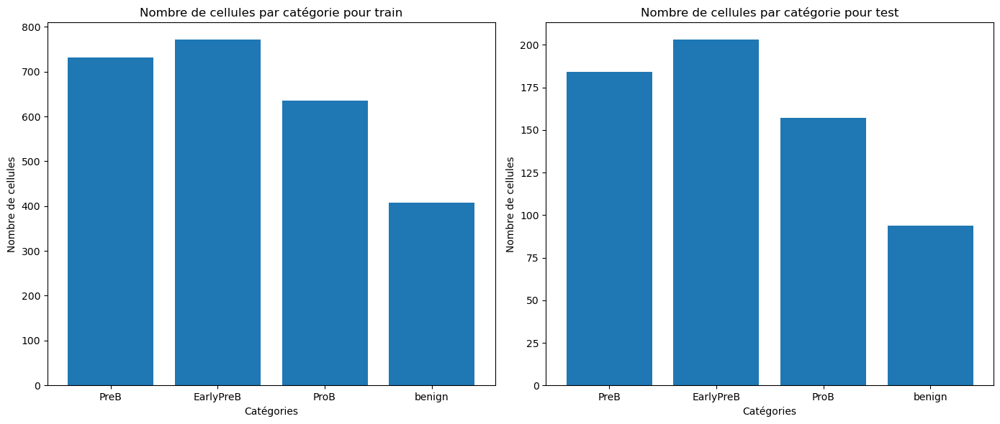

In [80]:
import matplotlib.pyplot as plt

labels = ['PreB', 'EarlyPreB', 'ProB', 'benign']

train_values = train_df_grouped['label'].value_counts()
test_values = test_df_grouped['label'].value_counts()

# Configuration de la figure et des sous-graphiques
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Tracer les données pour l'ensemble d'entraînement
axs[0].bar(labels, train_values[labels])
axs[0].set_xlabel('Catégories')
axs[0].set_ylabel('Nombre de cellules')
axs[0].set_title('Nombre de cellules par catégorie pour train')

# Tracer les données pour l'ensemble de test
axs[1].bar(labels, test_values[labels])
axs[1].set_xlabel('Catégories')
axs[1].set_ylabel('Nombre de cellules')
axs[1].set_title('Nombre de cellules par catégorie pour test')

# Ajuster l'espacement entre les sous-graphiques
fig.tight_layout()

# Afficher la figure
plt.show()

Ces résultats indiquent un déséquilibre entre les classes, ce qui pourrait avoir un impact sur l'entraînement du modèle.

Comme solution nous proposons de faire un sous-échantillonnage des classes majoritaires pour correspondre à la taille de la classe minoritaire la plus petite

In [75]:
from sklearn.utils import resample

# Calculer la taille minimale d'échantillon dans les ensembles d'entraînement et de test
min_samples_train = train_df_grouped['label'].value_counts().min()
min_samples_test = test_df_grouped['label'].value_counts().min()

# Fonction pour rééchantillonner les données
def resample_data(df, min_samples):
    resampled_dfs = []
    grouped = df.groupby(('label','first'))
    for label, group in grouped:
        if len(group) > min_samples:
            resampled_df = resample(group, replace=False, n_samples=min_samples, random_state=42)
        else:
            resampled_df = group
        resampled_dfs.append(resampled_df)
    return pd.concat(resampled_dfs)

# Rééchantillonner les données d'entraînement et de test séparément
resampled_train_df = resample_data(train_df_grouped, min_samples_train)
resampled_test_df = resample_data(test_df_grouped, min_samples_test)

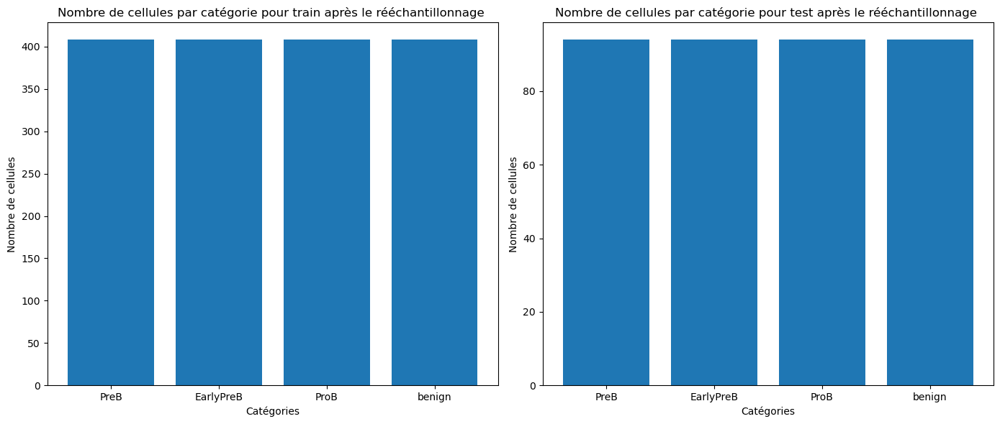

In [81]:
# Calculer les valeurs de comptage pour les ensembles d'entraînement et de test
train_values = resampled_train_df['label'].value_counts()
test_values = resampled_test_df['label'].value_counts()

# Labels pour les catégories
labels = ['PreB', 'EarlyPreB', 'ProB', 'benign']

# Configuration de la figure et des sous-graphiques
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Tracer les données pour l'ensemble d'entraînement
axs[0].bar(labels, train_values[labels])
axs[0].set_xlabel('Catégories')
axs[0].set_ylabel('Nombre de cellules')
axs[0].set_title('Nombre de cellules par catégorie pour train après le rééchantillonnage ')

# Tracer les données pour l'ensemble de test
axs[1].bar(labels, test_values[labels])
axs[1].set_xlabel('Catégories')
axs[1].set_ylabel('Nombre de cellules')
axs[1].set_title('Nombre de cellules par catégorie pour test après le rééchantillonnage ')

# Ajuster l'espacement entre les sous-graphiques
fig.tight_layout()

# Afficher la figure
plt.show()


In [40]:
# Regrouper par étiquette et calculer la moyenne de la colonne : cells_in_image
# combined_df.groupby('label').mean()['cells_in_image']

# # Ajouter une autre colonne nommée : avg_cells
# combined_df['avg_cells'] = combined_df.groupby('label')['cells_in_image'].transform('mean')

# # Supprimer la colonne cells_in_image
# combined_df = combined_df.drop('cells_in_image', axis=1)

Toutes les données sont au bon format.

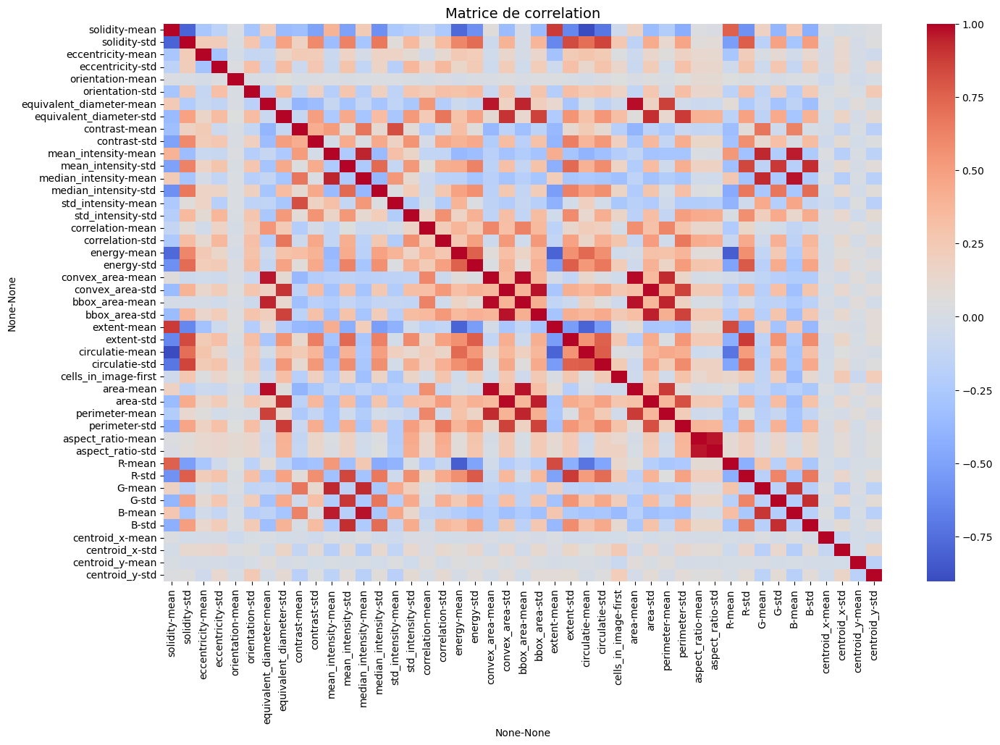

In [89]:
plt.figure(figsize=(16, 10))
sns.heatmap(train_df_grouped.drop(columns=[('label', 'first')]).corr(), annot=False, cmap='coolwarm')
plt.title('Matrice de correlation', fontsize=14)
plt.show()

Il est difficile de déterminer visuellement quelles caractéristiques sont les plus importantes et indépendantes.

C'est pourquoi nous avons besoin d'une technique de sélection

## Mise à l'échelle des données

In [90]:

# Supprimer la colonne d'étiquette avant la mise à l'échelle
train_features = train_df_grouped.drop(columns=['label'])
test_features = test_df_grouped.drop(columns=['label'])

resampled_train_features = resampled_train_df.drop(columns=['label'])
resampled_test_features = resampled_test_df.drop(columns=['label'])

# Mettre à l'échelle les caractéristiques
scaler = StandardScaler()
scaler.fit(train_features)

scaled_train_features = scaler.transform(train_features)
scaled_test_features = scaler.transform(test_features)

scaled_resampled_train_features = scaler.transform(resampled_train_features)
scaled_resampled_test_features = scaler.transform(resampled_test_features)


# Convertir les caractéristiques mises à l'échelle en DataFrames
scaled_train_df = pd.DataFrame(scaled_train_features, columns=train_features.columns, index=train_df_grouped.index)
scaled_test_df = pd.DataFrame(scaled_test_features, columns=test_features.columns, index=test_df_grouped.index)

scaled_resampled_train_df = pd.DataFrame(scaled_resampled_train_features, columns=resampled_train_features.columns, index=resampled_train_df.index)
scaled_resampled_test_df = pd.DataFrame(scaled_resampled_test_features, columns=resampled_test_features.columns, index=resampled_test_df.index)

# Combiner les caractéristiques mises à l'échelle avec les étiquettes et les clés
scaled_train_df['label'] = train_df_grouped['label']
scaled_test_df['label'] = test_df_grouped['label']

scaled_resampled_train_df['label'] = resampled_train_df['label']
scaled_resampled_test_df['label'] = resampled_test_df['label']


## Méthodes de sélection de caractéristiques pour l'apprentissage automatique
Nous utiliserons la méthode de sélection des caractéristiques suivante pour sélectionner les caractéristiques les plus importantes : la Méthode d'Élimination des Caractéristiques Récursives (RFE) en utilisant la régression logistique.

In [53]:
# X = scaled_combined_df.drop(columns=['label'])
# y = scaled_combined_df['label']

In [95]:
X_train =scaled_train_df.drop(columns=['label'])
y_train = scaled_train_df['label']

X_test =  scaled_test_df.drop(columns=['label'])
y_test = scaled_test_df['label']

In [96]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(2546, 45)
(2546,)
(638, 45)
(638,)


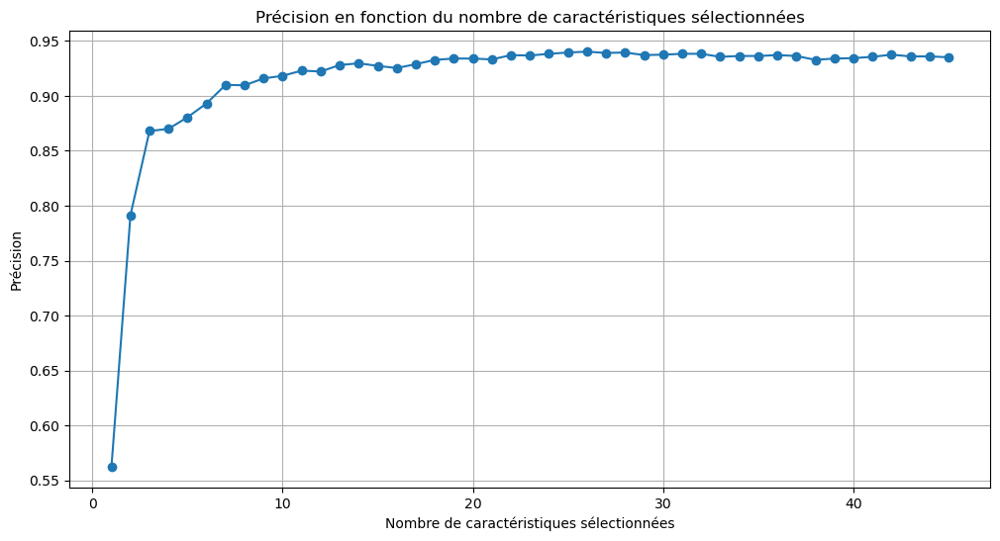

In [97]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score

# Votre dataset
noms_caracteristiques = X_train.columns

# Initialiser le modèle
modele = LogisticRegression(max_iter=10000)

# Stocker les précisions
precisions = []

# Effectuer la RFE pour différents nombres de caractéristiques
for n in range(1, len(noms_caracteristiques) + 1):
    rfe = RFE(estimator=modele, n_features_to_select=n)
    fit = rfe.fit(X_train, y_train)
    
    # Évaluer la précision en utilisant la validation croisée
    score = np.mean(cross_val_score(fit, X_train, y_train, cv=5))
    precisions.append(score)

# Tracer le graphique
plt.figure(figsize=(12, 6))
plt.plot(range(1, len(noms_caracteristiques) + 1), precisions, marker='o')
plt.xlabel('Nombre de caractéristiques sélectionnées')
plt.ylabel('Précision')
plt.title('Précision en fonction du nombre de caractéristiques sélectionnées')
plt.grid(True)
plt.show()


On constate que après 25 caractéristiques, la précision reste quasiment identique. Par conséquent, il est suffisant de sélectionner uniquement 25 caractéristiques.

In [108]:
best_precision = max(precisions)
# Trouver le nombre optimal de caractéristiques
nombre_optimal_caracteristiques = np.argmax(precisions) + 1
    
print(f'Meilleure précision: {best_precision}')
print(f'Nombre optimal: {nombre_optimal_caracteristiques}')

Meilleure précision: 0.9403012442698101
Nombre optimal: 26


In [109]:
# Réexécuter RFE avec le nombre optimal de caractéristiques
rfe = RFE(estimator=modele, n_features_to_select=nombre_optimal_caracteristiques)
fit = rfe.fit(X_train, y_train)

# Obtenez les noms des caractéristiques sélectionnées
caracteristiques_selectionnees = np.array(noms_caracteristiques)[fit.support_]

print("Noms des caractéristiques sélectionnées:", caracteristiques_selectionnees.tolist())

Noms des caractéristiques sélectionnées: [('solidity', 'mean'), ('solidity', 'std'), ('equivalent_diameter', 'mean'), ('equivalent_diameter', 'std'), ('contrast', 'mean'), ('mean_intensity', 'mean'), ('mean_intensity', 'std'), ('median_intensity', 'mean'), ('median_intensity', 'std'), ('correlation', 'mean'), ('correlation', 'std'), ('convex_area', 'mean'), ('convex_area', 'std'), ('bbox_area', 'mean'), ('bbox_area', 'std'), ('extent', 'mean'), ('cells_in_image', 'first'), ('area', 'mean'), ('area', 'std'), ('perimeter', 'mean'), ('perimeter', 'std'), ('R', 'mean'), ('G', 'mean'), ('G', 'std'), ('B', 'mean'), ('B', 'std')]


Définir une dataframe pour les caractéristiques selectionnées

In [134]:
# nouvelles_colonnes = caracteristiques_selectionnees_rfe.tolist()
nouvelles_colonnes = caracteristiques_selectionnees.tolist()
# nouvelles_colonnes.append('label')
print(nouvelles_colonnes)

[('solidity', 'mean'), ('solidity', 'std'), ('equivalent_diameter', 'mean'), ('equivalent_diameter', 'std'), ('contrast', 'mean'), ('mean_intensity', 'mean'), ('mean_intensity', 'std'), ('median_intensity', 'mean'), ('median_intensity', 'std'), ('correlation', 'mean'), ('correlation', 'std'), ('convex_area', 'mean'), ('convex_area', 'std'), ('bbox_area', 'mean'), ('bbox_area', 'std'), ('extent', 'mean'), ('cells_in_image', 'first'), ('area', 'mean'), ('area', 'std'), ('perimeter', 'mean'), ('perimeter', 'std'), ('R', 'mean'), ('G', 'mean'), ('G', 'std'), ('B', 'mean'), ('B', 'std')]


In [135]:
# Convertir les noms des caractéristiques sélectionnées en un DataFrame
scaled_train_df_selected = scaled_train_df[caracteristiques_selectionnees]
scaled_test_df_selected = scaled_test_df[caracteristiques_selectionnees]

## Entrainement

In [136]:
x_train_selected = scaled_train_df[caracteristiques_selectionnees]
y_train = scaled_train_df['label']

x_test_selected =  scaled_test_df[caracteristiques_selectionnees]
y_test = scaled_test_df['label']

In [138]:
print(x_train_selected.shape)
print(y_train.shape)
print(x_test_selected.shape)
print(y_test.shape)

(2546, 26)
(2546,)
(638, 26)
(638,)


In [139]:
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score,precision_score,recall_score,accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier

### KNN

In [145]:
# # Générer une plage de valeurs pour K
# neig = np.arange(1, 15)

# # Listes pour stocker les scores de précision d'entraînement et de test
# train_accuracy = []
# test_accuracy = []

# # Itérer sur différentes valeurs de K
# for k in neig:
#     knn = KNeighborsClassifier(n_neighbors=k)
#     knn.fit(x_train_selected, y_train)
#     train_accuracy.append(knn.score(x_train_selected, y_train))
#     test_accuracy.append(knn.score(x_test_selected, y_test)) 

# # Trouver la valeur de K avec la meilleure précision de test
# meilleur_k = np.argmax(test_accuracy) + 1
# meilleure_precision = np.max(test_accuracy)

# print("Best accuracy is {} with K = {}".format(meilleure_precision, meilleur_k))

# # Tracer la précision d'entraînement et de test
# plt.figure(figsize=(10, 6))
# # Tracer la précision d'entraînement et de test
# plt.figure(figsize=(10, 6))
# plt.plot(neig, train_accuracy, label='Train Accuracy', marker='o')
# plt.plot(neig, test_accuracy, label='Test Accuracy', marker='o')
# plt.title('KNN Accuracy vs. Number of Neighbors')
# plt.xlabel('Number of Neighbors (K)')
# plt.ylabel('Accuracy')
# plt.xticks(neig)
# plt.legend()
# plt.grid(True)
# plt.show()

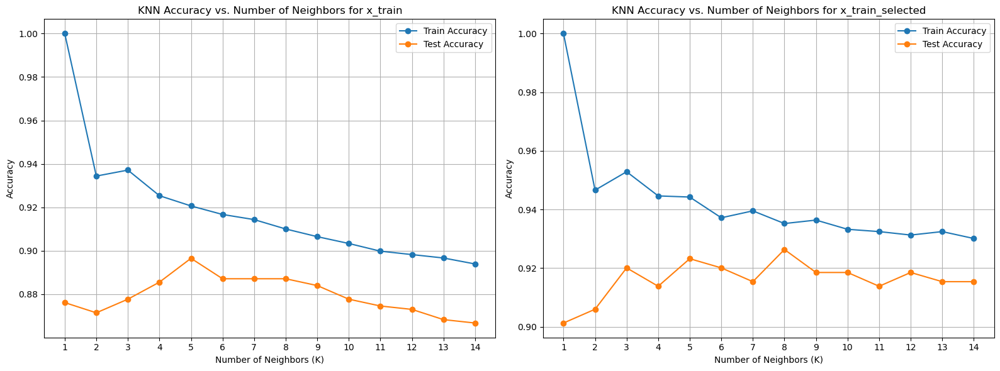

In [142]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier

# Générer une plage de valeurs pour K
neig = np.arange(1, 15)

# Créer une figure et deux sous-graphiques côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Première itération pour x_train
train_accuracy = []
test_accuracy = []
for k in neig:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train, y_train)
    train_accuracy.append(knn.score(X_train, y_train))
    test_accuracy.append(knn.score(X_test, y_test)) 

meilleur_k_x_train = np.argmax(test_accuracy) + 1
meilleure_precision_x_train = np.max(test_accuracy)

ax1.plot(neig, train_accuracy, label='Train Accuracy', marker='o')
ax1.plot(neig, test_accuracy, label='Test Accuracy', marker='o')
ax1.set_title('KNN Accuracy vs. Number of Neighbors for x_train')
ax1.set_xlabel('Number of Neighbors (K)')
ax1.set_ylabel('Accuracy')
ax1.set_xticks(neig)
ax1.legend()
ax1.grid(True)

# Deuxième itération pour x_train_selected
train_accuracy_selected = []
test_accuracy_selected = []
for k in neig:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(x_train_selected, y_train)
    train_accuracy_selected.append(knn.score(x_train_selected, y_train))
    test_accuracy_selected.append(knn.score(x_test_selected, y_test)) 

meilleur_k_x_train_selected = np.argmax(test_accuracy_selected) + 1
meilleure_precision_x_train_selected = np.max(test_accuracy_selected)

ax2.plot(neig, train_accuracy_selected, label='Train Accuracy', marker='o')
ax2.plot(neig, test_accuracy_selected, label='Test Accuracy', marker='o')
ax2.set_title('KNN Accuracy vs. Number of Neighbors for x_train_selected')
ax2.set_xlabel('Number of Neighbors (K)')
ax2.set_ylabel('Accuracy')
ax2.set_xticks(neig)
ax2.legend()
ax2.grid(True)

# Afficher les graphiques
plt.tight_layout()
plt.show()


In [144]:
print("Best accuracy for x_train_selected is {} with K = {}".format(meilleure_precision_x_train_selected, meilleur_k_x_train_selected))
print("Best accuracy for x_train is {} with K = {}".format(meilleure_precision_x_train, meilleur_k_x_train))


Best accuracy for x_train_selected is 0.9263322884012539 with K = 8
Best accuracy for x_train is 0.896551724137931 with K = 5


In [151]:
knn = KNeighborsClassifier(n_neighbors=meilleur_k_x_train_selected)
knn.fit(x_train_selected,y_train)
predicted = knn.predict(x_test_selected)
score = knn.score(x_test_selected, y_test)
knn_score_ = np.mean(score)

accuracy = accuracy_score(y_test, predicted)
print('Accuracy: %.3f' % accuracy)

Accuracy: 0.926


In [152]:
print('Classification report')
print(metrics.classification_report(y_test, predicted))

Classification report
              precision    recall  f1-score   support

   EarlyPreB       0.89      0.91      0.90       203
        PreB       0.93      0.92      0.92       184
        ProB       0.99      1.00      1.00       157
      benign       0.89      0.85      0.87        94

    accuracy                           0.93       638
   macro avg       0.93      0.92      0.92       638
weighted avg       0.93      0.93      0.93       638



In [182]:
# # Calculer la matrice de confusion avec les noms de classe
# cf_matrix = confusion_matrix(y_test, predicted, labels=label_encoder.classes_)

# # Créer une heatmap de la matrice de confusion avec les noms de classe
# sns.heatmap(cf_matrix, cmap="PuBu", annot=True, fmt='.0f', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
# plt.xlabel('Predicted')
# plt.ylabel('Actual')
# plt.title('Confusion Matrix')
# plt.show()


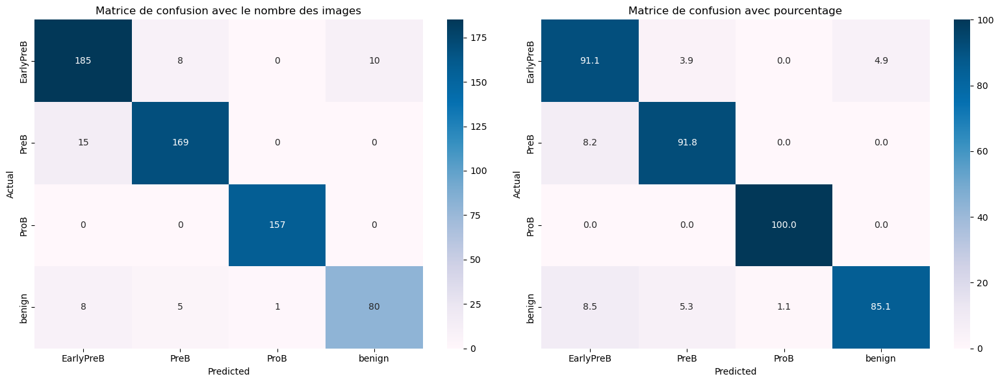

In [160]:
from sklearn.preprocessing import LabelEncoder

# Créer et entraîner le LabelEncoder
label_encoder = LabelEncoder()
label_encoder.fit(y_train)

# Utiliser le LabelEncoder pour transformer les étiquettes en valeurs numériques
y_test_encoded = label_encoder.transform(y_test)
predicted_encoded = label_encoder.transform(predicted)

# Calculer la matrice de confusion avec les noms de classe
cf_matrix = confusion_matrix(y_test_encoded, predicted_encoded)

# Calculate total samples in each class
class_totals = np.sum(cf_matrix, axis=1)

# Compute the percentage for each cell in the confusion matrix
cf_matrix_percentage = np.round((cf_matrix.T / class_totals).T * 100, decimals=1)

# Créer une figure avec deux sous-graphiques côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot de la première matrice de confusion
sns.heatmap(cf_matrix, cmap="PuBu", annot=True, fmt='.0f', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_, ax=ax1)
ax1.set_xlabel('Predicted')
ax1.set_ylabel('Actual')
ax1.set_title('Matrice de confusion avec le nombre des images')

# Plot de la deuxième matrice de confusion
sns.heatmap(cf_matrix_percentage, cmap="PuBu", annot=True, fmt=".1f", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_, ax=ax2)
ax2.set_xlabel('Predicted')
ax2.set_ylabel('Actual')
ax2.set_title('Matrice de confusion avec pourcentage')

# Afficher les graphiques
plt.tight_layout()
plt.show()


### SVM

In [161]:
# Paramètres à rechercher pour SVM
param_grid_svm = [
    {"kernel": ["linear"], "C": [1, 10]},
    {"kernel": ["poly"], "C":[1, 10]},
    {"kernel": ["rbf"], "gamma": [1e-3, 1e-4], "C": [1, 10]}
]

# Entraîner SVM sur X_train
SVM_grid_x_train = GridSearchCV(svm.SVC(), param_grid_svm, cv=5)
SVM_grid_x_train.fit(X_train, y_train)

# Afficher les meilleurs paramètres et la meilleure précision pour X_train
print("Best parameters for X_train:", SVM_grid_x_train.best_params_)
print("Best accuracy for X_train:", SVM_grid_x_train.best_score_)

# Entraîner SVM sur x_train_selected
SVM_grid_x_train_selected = GridSearchCV(svm.SVC(), param_grid_svm, cv=5)
SVM_grid_x_train_selected.fit(x_train_selected, y_train)

# Afficher les meilleurs paramètres et la meilleure précision pour x_train_selected
print("Best parameters for x_train_selected:", SVM_grid_x_train_selected.best_params_)
print("Best accuracy for x_train_selected:", SVM_grid_x_train_selected.best_score_)


Best parameters for X_train: {'C': 10, 'gamma': 0.001, 'kernel': 'rbf'}
Best accuracy for X_train: 0.9391240032358719
Best parameters for x_train_selected: {'C': 10, 'kernel': 'linear'}
Best accuracy for x_train_selected: 0.9410840171038946


In [204]:
svm_clf = svm.SVC(**SVM_grid_x_train_selected.best_params_)
svm_clf.fit(x_train_selected,y_train)
predicted = svm_clf.predict(x_test_selected)
score = svm_clf.score(x_test_selected, y_test)
svm_score_ = np.mean(score)

print('Accuracy : %.3f' % (svm_score_))

print("report ")
print(metrics.classification_report(y_test, predicted))

Accuracy : 0.931
report 
              precision    recall  f1-score   support

   EarlyPreB       0.89      0.91      0.90       203
        PreB       0.95      0.89      0.92       184
        ProB       1.00      1.00      1.00       157
      benign       0.87      0.94      0.90        94

    accuracy                           0.93       638
   macro avg       0.93      0.93      0.93       638
weighted avg       0.93      0.93      0.93       638



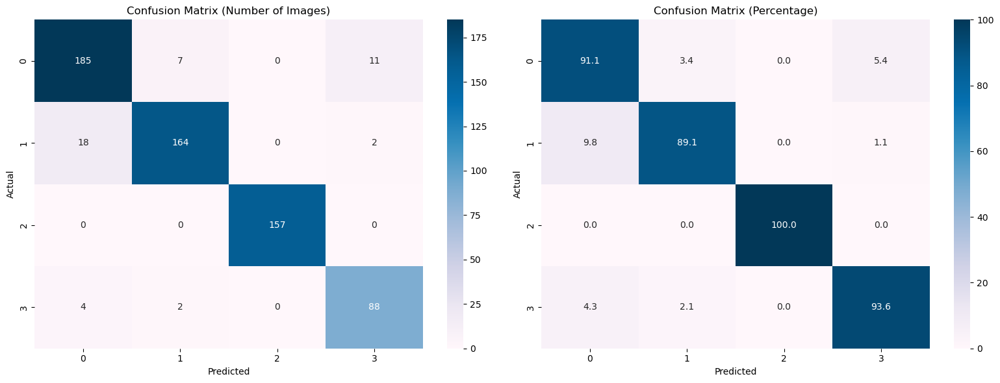

In [205]:
cf_matrix_svm = confusion_matrix(y_test, predicted)
# Calculer le nombre total d'échantillons dans chaque classe
class_totals = np.sum(cf_matrix_svm, axis=1)

# Calculer la matrice de confusion avec les pourcentages
cf_matrix_percentage_svm = np.round((cf_matrix_svm.T / class_totals).T * 100, decimals=1)

# Créer une figure avec deux sous-graphiques côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot de la première matrice de confusion avec les nombres d'images
sns.heatmap(cf_matrix_svm, cmap="PuBu", annot=True, fmt='.0f', ax=ax1)
ax1.set_xlabel('Predicted')
ax1.set_ylabel('Actual')
ax1.set_title('Confusion Matrix (Number of Images)')

# Plot de la deuxième matrice de confusion avec les pourcentages
sns.heatmap(cf_matrix_percentage_svm, cmap="PuBu", annot=True, fmt='.1f', ax=ax2)
ax2.set_xlabel('Predicted')
ax2.set_ylabel('Actual')
ax2.set_title('Confusion Matrix (Percentage)')

# Afficher les graphiques
plt.tight_layout()
plt.show()


### Arbre de decision

In [177]:
# param_grid_dt = {
#     'max_depth': [None, 10, 20],
#     'min_samples_split': [2, 5, 10],
#     'min_samples_leaf': [1, 2, 4],
#     'criterion': ['gini', 'entropy']
# }

# dt = DecisionTreeClassifier()

# dt_grid = GridSearchCV(estimator=dt, param_grid=param_grid_dt, cv=5)

# dt_grid.fit(x_train, y_train)

In [178]:
# Paramètres à rechercher pour l'arbre de décision
param_grid_dt = {
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'criterion': ['gini', 'entropy']
}

# Créer l'estimateur DecisionTreeClassifier
dt = DecisionTreeClassifier()

# Rechercher les meilleurs hyperparamètres avec GridSearchCV pour X_train
dt_grid_X_train = GridSearchCV(estimator=dt, param_grid=param_grid_dt, cv=5)
dt_grid_X_train.fit(X_train, y_train)

# Afficher les meilleurs paramètres et la meilleure précision pour X_train
print("Best parameters for X_train:", dt_grid_X_train.best_params_)
print("Best accuracy for X_train:", dt_grid_X_train.best_score_)

# Rechercher les meilleurs hyperparamètres avec GridSearchCV pour x_train_selected
dt_grid_x_train_selected = GridSearchCV(estimator=dt, param_grid=param_grid_dt, cv=5)
dt_grid_x_train_selected.fit(x_train_selected, y_train)

# Afficher les meilleurs paramètres et la meilleure précision pour x_train_selected
print("Best parameters for x_train_selected:", dt_grid_x_train_selected.best_params_)
print("Best accuracy for x_train_selected:", dt_grid_x_train_selected.best_score_)


Best parameters for X_train: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 2}
Best accuracy for X_train: 0.9041650294695482
Best parameters for x_train_selected: {'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best accuracy for x_train_selected: 0.9010231518933705


Presque sont les memes precisions

In [184]:

dt = DecisionTreeClassifier(**dt_grid_x_train_selected.best_params_, random_state=5)
dt.fit(x_train_selected, y_train)
predicted_x_train_selected = dt.predict(x_test_selected)
score = dt.score(x_test_selected, y_test)
dt_score_ = np.mean(score)

print('Accuracy : %.3f' % (dt_score_))

print("report")
print(metrics.classification_report(y_test, predicted_x_train_selected))

Accuracy : 0.889
report
              precision    recall  f1-score   support

   EarlyPreB       0.86      0.85      0.85       203
        PreB       0.89      0.91      0.90       184
        ProB       0.98      0.99      0.99       157
      benign       0.78      0.77      0.77        94

    accuracy                           0.89       638
   macro avg       0.88      0.88      0.88       638
weighted avg       0.89      0.89      0.89       638



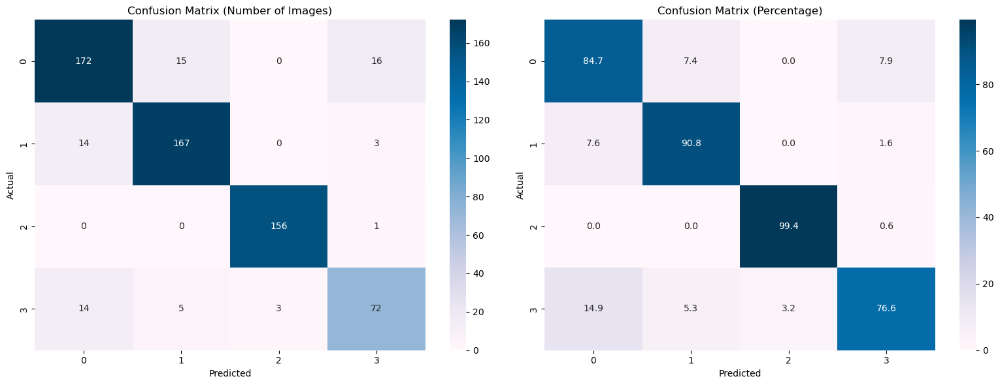

In [185]:

# Calculer la matrice de confusion avec les nombres d'images
cf_matrix_dt = confusion_matrix(y_test, predicted_x_train_selected)

# Calculer la matrice de confusion avec les pourcentages
class_totals = np.sum(cf_matrix_dt, axis=1)
cf_matrix_percentage_dt = np.round((cf_matrix_dt.T / class_totals).T * 100, decimals=1)

# Créer une figure avec deux sous-graphiques côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot de la première matrice de confusion avec les nombres d'images
sns.heatmap(cf_matrix_dt, cmap="PuBu", annot=True, fmt='.0f', ax=ax1)
ax1.set_xlabel('Predicted')
ax1.set_ylabel('Actual')
ax1.set_title('Confusion Matrix (Number of Images)')

# Plot de la deuxième matrice de confusion avec les pourcentages
sns.heatmap(cf_matrix_percentage_dt, cmap="PuBu", annot=True, fmt='.1f', ax=ax2)
ax2.set_xlabel('Predicted')
ax2.set_ylabel('Actual')
ax2.set_title('Confusion Matrix (Percentage)')

# Afficher les graphiques
plt.tight_layout()
plt.show()


### Foret aléatoire

In [186]:

# param_grid_rf = {
#     "n_estimators": [100, 200],
#     "criterion": ["gini", "entropy"],
#     "max_depth": [None, 10, 20],
# }

# RF_grid = GridSearchCV(estimator=RandomForestClassifier(), param_grid=param_grid_rf, cv= 5)
# RF_grid.fit(x_train, y_train)

# print(RF_grid.best_params_)

In [187]:
# Paramètres à rechercher pour RandomForestClassifier
param_grid_rf = {
    "n_estimators": [100, 200],
    "criterion": ["gini", "entropy"],
    "max_depth": [None, 10, 20],
}

# Créer l'estimateur RandomForestClassifier
rf = RandomForestClassifier()

# Rechercher les meilleurs hyperparamètres avec GridSearchCV pour X_train
RF_grid_X_train = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5)
RF_grid_X_train.fit(X_train, y_train)

# Afficher les meilleurs paramètres et la meilleure précision pour X_train
print("Best parameters for X_train:", RF_grid_X_train.best_params_)
print("Best accuracy for X_train:", RF_grid_X_train.best_score_)

# Rechercher les meilleurs hyperparamètres avec GridSearchCV pour x_train_selected
RF_grid_x_train_selected = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5)
RF_grid_x_train_selected.fit(x_train_selected, y_train)

# Afficher les meilleurs paramètres et la meilleure précision pour x_train_selected
print("Best parameters for x_train_selected:", RF_grid_x_train_selected.best_params_)
print("Best accuracy for x_train_selected:", RF_grid_x_train_selected.best_score_)


Best parameters for X_train: {'criterion': 'gini', 'max_depth': None, 'n_estimators': 100}
Best accuracy for X_train: 0.9387295350360183
Best parameters for x_train_selected: {'criterion': 'gini', 'max_depth': None, 'n_estimators': 200}
Best accuracy for x_train_selected: 0.932052082129512


In [199]:
r_forest = RandomForestClassifier(**RF_grid_x_train_selected.best_params_, random_state=5)
r_forest.fit(x_train_selected,y_train)
predicted_x_train_selected = r_forest.predict(x_test_selected)
score = r_forest.score(x_test_selected, y_test)
rf_score_ = np.mean(score)

print('Accuracy : %.3f' % (rf_score_))
print("report")
print(metrics.classification_report(y_test, predicted_x_train_selected))


Accuracy : 0.929
report
              precision    recall  f1-score   support

   EarlyPreB       0.91      0.88      0.90       203
        PreB       0.97      0.92      0.94       184
        ProB       0.98      1.00      0.99       157
      benign       0.82      0.93      0.87        94

    accuracy                           0.93       638
   macro avg       0.92      0.93      0.93       638
weighted avg       0.93      0.93      0.93       638



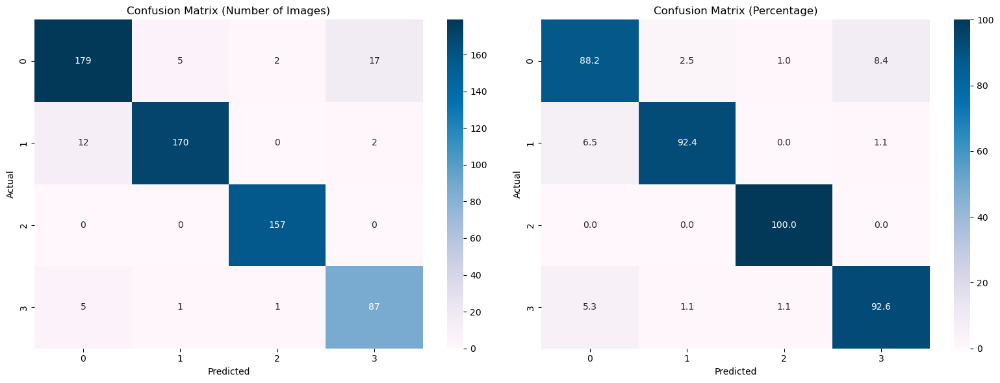

In [200]:

# Calculer la matrice de confusion avec les nombres d'images
cf_matrix_rf = confusion_matrix(y_test, predicted_x_train_selected)

# Calculer la matrice de confusion avec les pourcentages
class_totals = np.sum(cf_matrix_rf, axis=1)
cf_matrix_percentage_rf = np.round((cf_matrix_rf.T / class_totals).T * 100, decimals=1)

# Créer une figure avec deux sous-graphiques côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot de la première matrice de confusion avec les nombres d'images
sns.heatmap(cf_matrix_rf, cmap="PuBu", annot=True, fmt='.0f', ax=ax1)
ax1.set_xlabel('Predicted')
ax1.set_ylabel('Actual')
ax1.set_title('Confusion Matrix (Number of Images)')

# Plot de la deuxième matrice de confusion avec les pourcentages
sns.heatmap(cf_matrix_percentage_rf, cmap="PuBu", annot=True, fmt='.1f', ax=ax2)
ax2.set_xlabel('Predicted')
ax2.set_ylabel('Actual')
ax2.set_title('Confusion Matrix (Percentage)')

# Afficher les graphiques
plt.tight_layout()
plt.show()


## Export des modèles

In [206]:
import pickle

In [207]:
# 1- knn
with open('../models/knn_model.pkl', 'wb') as file:
    pickle.dump(knn, file)

In [208]:
# 2- SVM 
with open('../models/svm_model.pkl', 'wb') as file:
    pickle.dump(svm_clf, file)

In [209]:
# 3- RF 
with open('../models/rf_model.pkl', 'wb') as file:
    pickle.dump(r_forest, file)

In [210]:
# 4- Dt
with open('../models/dt_model.pkl', 'wb') as file:
    pickle.dump(dt, file)

## Test 

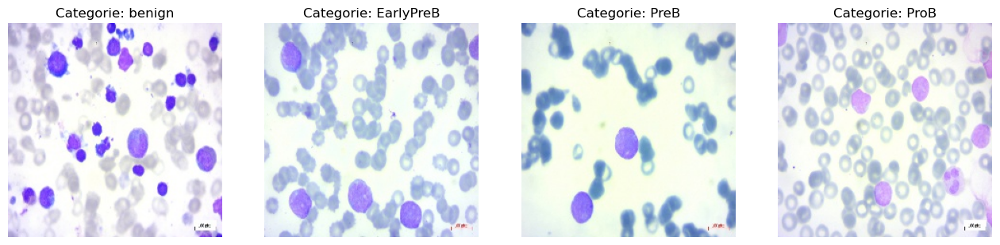

In [211]:
test_data_path = r'/media/lenovo/3830-5D3C/Blood-cell-detection/data/test_data'
categories = [category for category in os.listdir(test_data_path) if os.path.isdir(os.path.join(test_data_path, category))]
images_path = []

fig, axs = plt.subplots(1, 4, figsize=(16, 4))

for ax, category in zip(axs, categories):
    if os.listdir(os.path.join(test_data_path, category)):
        random_image = random.choice(os.listdir(os.path.join(test_data_path, category)))
        images_path.append(os.path.join(test_data_path, category, random_image))
        random_image = cv2.imread(os.path.join(test_data_path, category, random_image))
        random_image = cv2.cvtColor(random_image, cv2.COLOR_BGR2RGB)
        ax.imshow(random_image)
        ax.set_title(f"Categorie: {category}")
        ax.axis('off')

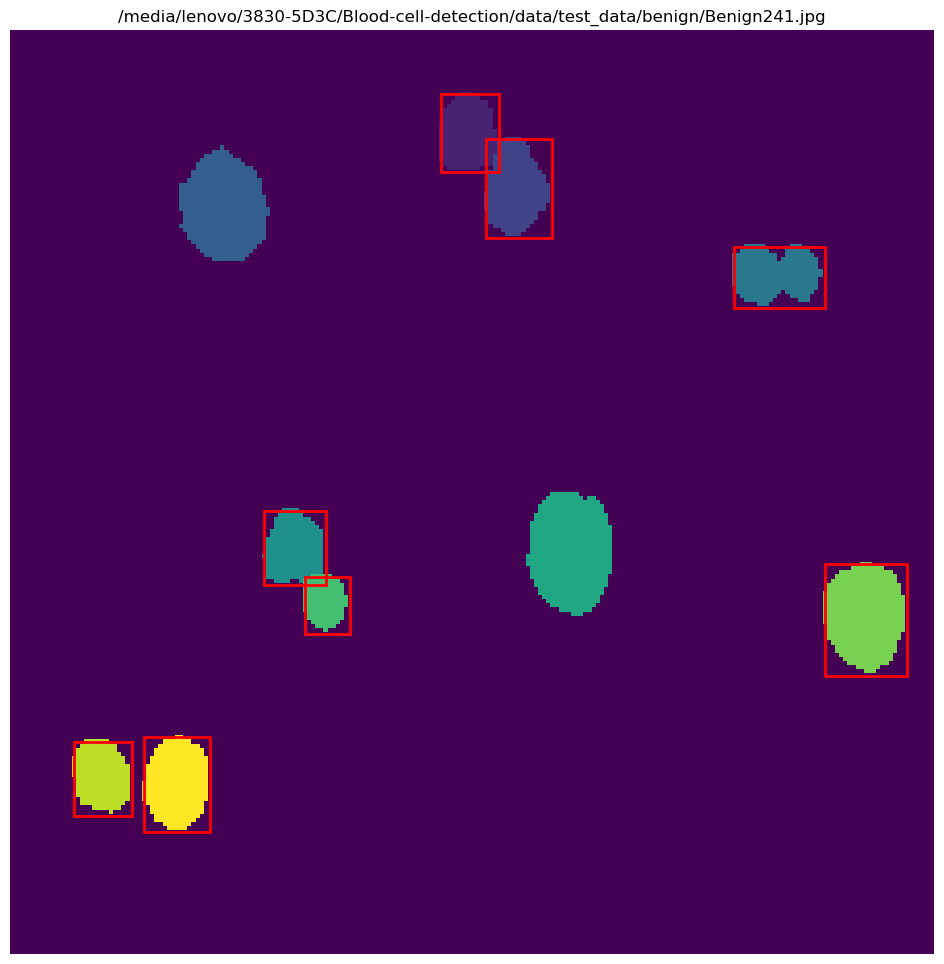

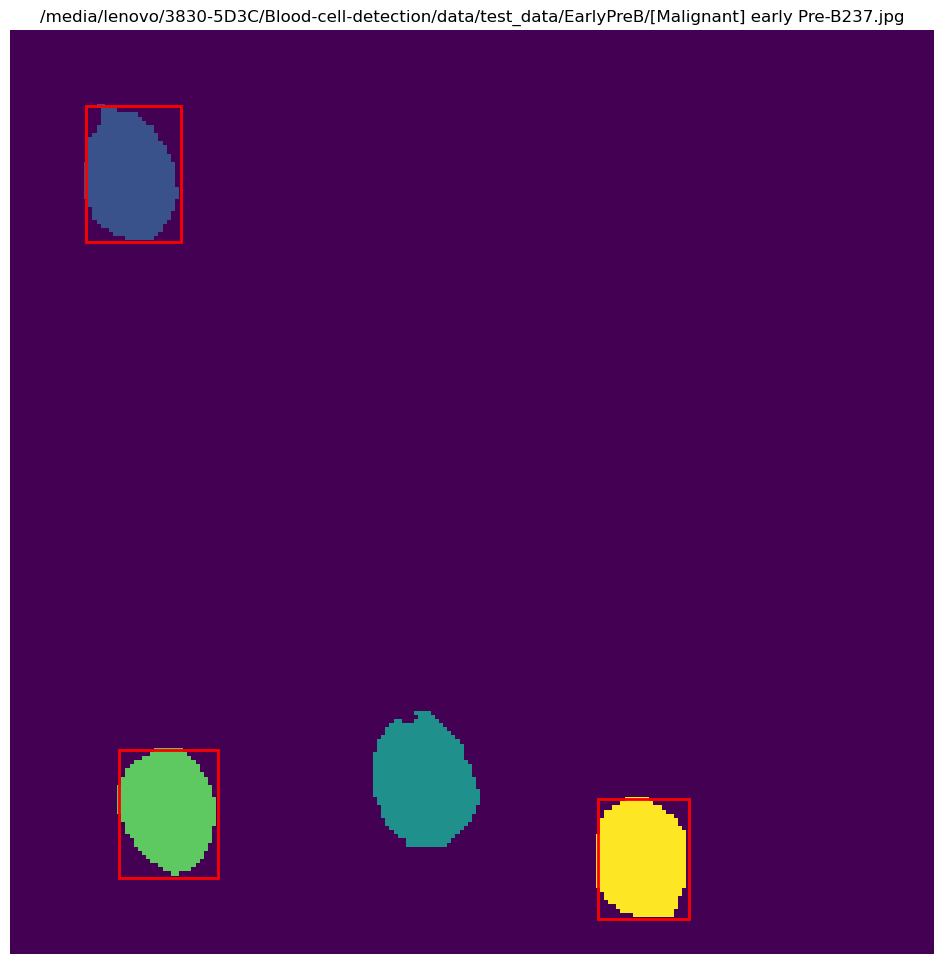

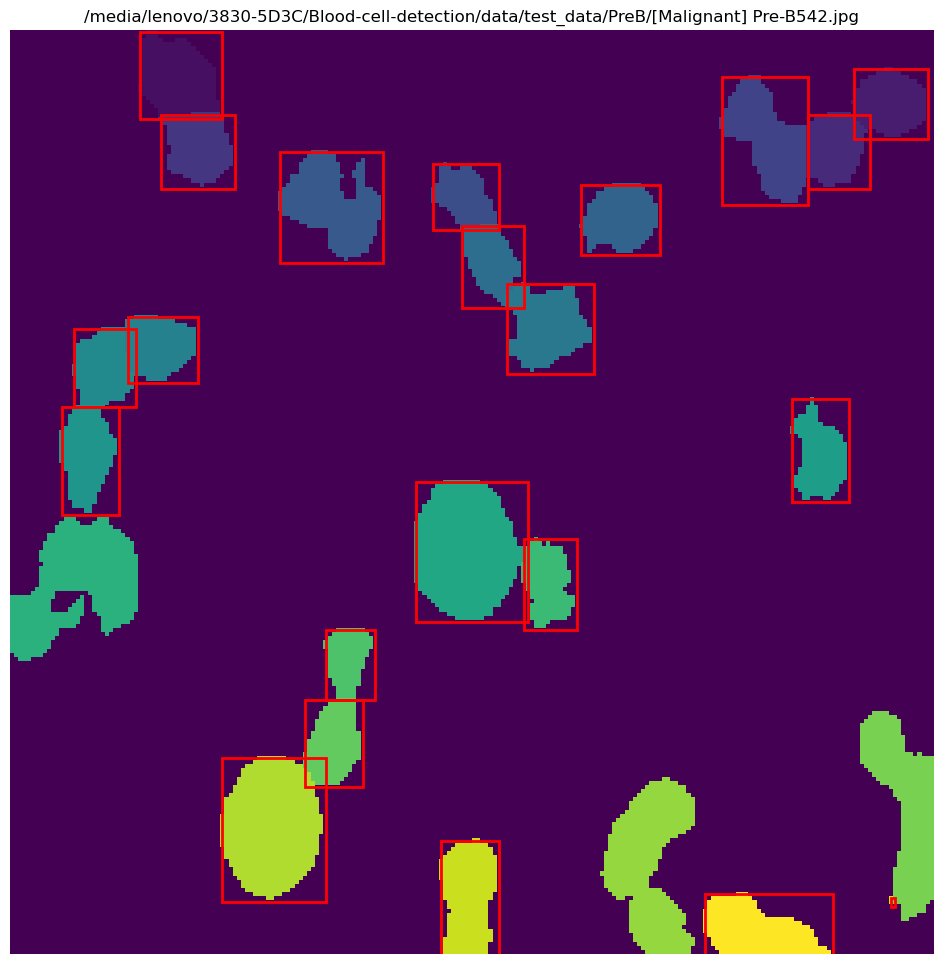

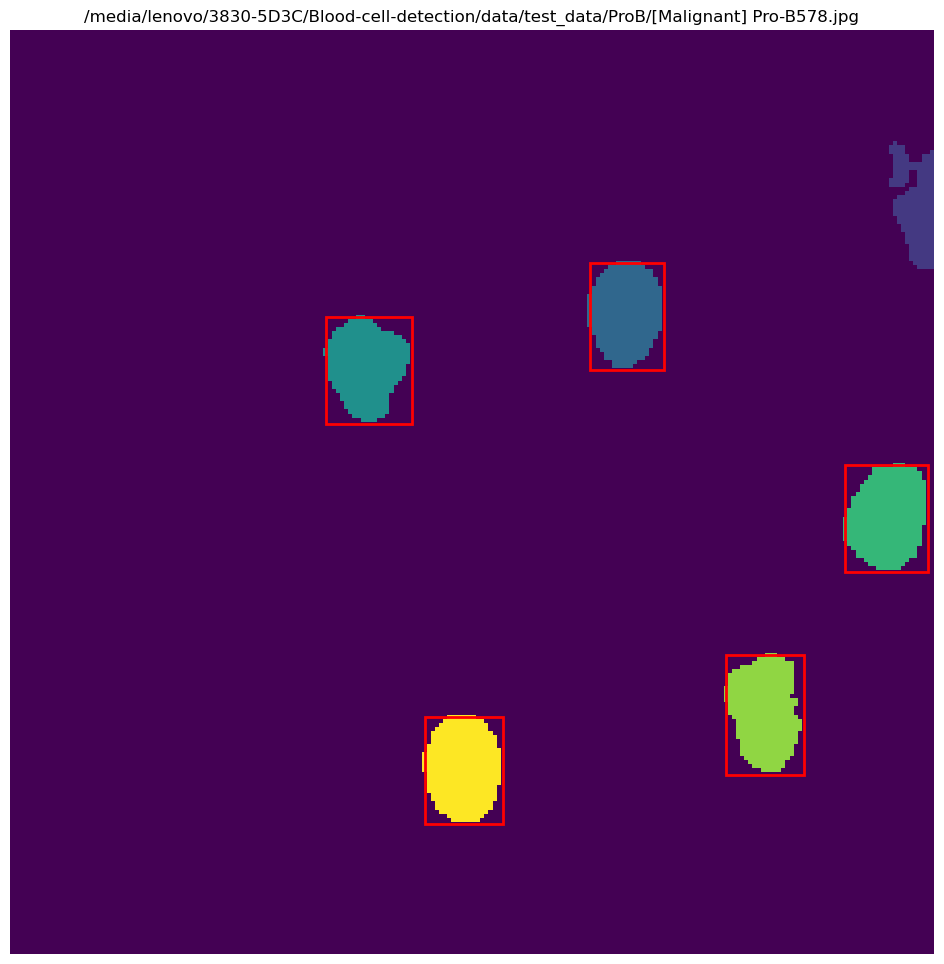

In [212]:

labeled_features_testing = []
process_images([cv2.imread(img) for img in images_path] ,images_path , labeled_features_testing,True)

In [213]:
df_labeled_features_testing = pd.DataFrame(labeled_features_testing)
df_labeled_features_testing.head()

,solidity,eccentricity,orientation,equivalent_diameter,color,contrast,mean_intensity,median_intensity,std_intensity,correlation,...,convex_area,bbox_area,extent,circulatie,cells_in_image,area,perimeter,aspect_ratio,label,image_index
0,0.964912,0.672936,-0.055302,16.736568,"[244.52631578947367, 108.8984962406015, 147.06...",3089.292398,166.829574,149.0,68.988674,-0.021997,...,228.0,266.0,0.827068,1.069848,10,220.0,54.384776,1.351898,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0
1,0.947552,0.769024,-0.003062,18.575465,"[246.1953125, 136.0546875, 188.84114583333334]",3606.234848,190.363715,196.5,61.088510,-0.002235,...,286.0,384.0,0.705729,1.191459,10,271.0,63.698485,1.564407,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0
2,0.878049,0.790216,1.567012,17.912464,"[236.12121212121212, 106.9121212121212, 138.52...",4123.447059,160.520202,170.0,73.984022,0.212320,...,287.0,330.0,0.763636,1.493420,10,252.0,68.769553,1.631777,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0
3,0.945701,0.571875,-0.120636,16.312788,"[247.28148148148148, 123.41111111111111, 169.3...",2650.500000,180.006173,174.0,63.082750,0.078536,...,221.0,270.0,0.774074,1.136227,10,209.0,54.627417,1.219005,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0
4,0.944000,0.612600,0.208760,12.257335,"[239.85714285714286, 106.44805194805195, 140.9...",5859.297619,162.406926,172.5,77.408870,0.047675,...,125.0,154.0,0.766234,1.024192,10,118.0,38.970563,1.265193,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0


In [214]:
df_labeled_features_testing['R'] = df_labeled_features_testing['color'].apply(lambda x: x[0])
df_labeled_features_testing['G'] = df_labeled_features_testing['color'].apply(lambda x: x[1])
df_labeled_features_testing['B'] = df_labeled_features_testing['color'].apply(lambda x: x[2])
df_labeled_features_testing = df_labeled_features_testing.drop('color', axis=1)

df_labeled_features_testing['centroid_x'] = df_labeled_features_testing['centroid'].apply(lambda x: x[1])
df_labeled_features_testing['centroid_y'] = df_labeled_features_testing['centroid'].apply(lambda x: x[0])
df_labeled_features_testing = df_labeled_features_testing.drop('centroid', axis=1)

In [330]:
# df_labeled_features_testing.groupby('label').mean()['cells_in_image']
# df_labeled_features_testing['avg_cells'] = df_labeled_features_testing.groupby('label')['cells_in_image'].transform('mean')
# df_labeled_features_testing = df_labeled_features_testing.drop('cells_in_image', axis=1)

In [215]:
df_labeled_features_testing.head()

,solidity,eccentricity,orientation,equivalent_diameter,contrast,mean_intensity,median_intensity,std_intensity,correlation,energy,...,area,perimeter,aspect_ratio,label,image_index,R,G,B,centroid_x,centroid_y
0,0.964912,0.672936,-0.055302,16.736568,3089.292398,166.829574,149.0,68.988674,-0.021997,0.056999,...,220.0,54.384776,1.351898,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0,244.526316,108.898496,147.063910,110.359091,24.754545
1,0.947552,0.769024,-0.003062,18.575465,3606.234848,190.363715,196.5,61.088510,-0.002235,0.048509,...,271.0,63.698485,1.564407,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0,246.195312,136.054688,188.841146,122.000000,37.937269
2,0.878049,0.790216,1.567012,17.912464,4123.447059,160.520202,170.0,73.984022,0.212320,0.047303,...,252.0,68.769553,1.631777,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0,236.121212,106.912121,138.527273,184.928571,58.662698
3,0.945701,0.571875,-0.120636,16.312788,2650.500000,180.006173,174.0,63.082750,0.078536,0.053576,...,209.0,54.627417,1.219005,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0,247.281481,123.411111,169.325926,68.354067,125.086124
4,0.944000,0.612600,0.208760,12.257335,5859.297619,162.406926,172.5,77.408870,0.047675,0.079860,...,118.0,38.970563,1.265193,/media/lenovo/3830-5D3C/Blood-cell-detection/d...,0,239.857143,106.448052,140.915584,75.711864,137.915254


In [216]:
# grouper par image_index  et former un vecteur de caractéristiques pour chaque image
labeled_features_testing_df = df_labeled_features_testing.groupby('image_index').agg({
    'solidity': ['mean', 'std'],
    'eccentricity': ['mean', 'std'],
    'orientation': ['mean', 'std'],
    'equivalent_diameter': ['mean', 'std'],
    'contrast': ['mean', 'std'],
    'mean_intensity': ['mean', 'std'],
    'median_intensity': ['mean', 'std'],
    'std_intensity': ['mean', 'std'],
    'correlation': ['mean', 'std'],
    'energy': ['mean', 'std'],
    'convex_area': ['mean', 'std'],
    'bbox_area': ['mean', 'std'],
    'extent': ['mean', 'std'],
    'circulatie': ['mean', 'std'],
    'cells_in_image': 'first',
    'area': ['mean', 'std'],
    'perimeter':  ['mean', 'std'],
    'aspect_ratio':  ['mean', 'std'],
    'R':  ['mean', 'std'],
    'G':  ['mean', 'std'],
    'B':  ['mean', 'std'],
    'centroid_x':  ['mean', 'std'],
    'centroid_y':  ['mean', 'std'],
    'label': 'first',
    })

labeled_features_testing_df.head()

solidity           eccentricity           orientation            \
                 mean       std         mean       std        mean       std   
image_index                                                                    
0            0.943792  0.027798     0.678313  0.075251    0.234969  0.558021   
1            0.961745  0.018220     0.675540  0.051748    0.199525  0.041051   
2            0.912183  0.046946     0.705221  0.192563    0.294526  0.610225   
3            0.949412  0.018882     0.705654  0.067436   -0.025195  0.146888   

            equivalent_diameter               contrast               ...  \
                           mean       std         mean          std  ...   
image_index                                                          ...   
0                     17.465902  3.053653  3673.366763  1108.761201  ...   
1                     26.373586  0.266016   950.707669   189.587647  ...   
2                     17.945463  5.475862  1268.282339   584.229330  ...   
3                     22.136649  0.455527   696.264607   210.928917  ...   

                     R           G                      B             \
                   std        mean        std        mean        std   
image_index                                                            
0             4.729704  119.606801  12.557266  157.835060  16.831544   
1             4.015203  151.847623   8.605817  167.122753  10.037279   
2            14.870796  170.460981  16.460082  144.894237  27.471064   
3             1.861451  185.293415   5.618281  214.854706   6.271804   

             centroid_x             centroid_y             \
                   mean        std        mean        std   
image_index                                                 
0            103.701665  65.927306  111.031195  62.363378   
1             72.940394  69.100421  141.306207  92.140724   
2            113.552094  63.500254   97.281528  69.192157   
3            147.695447  51.668234  122.002995  49.013948   

                                                         label  
                                                         first  
image_index                                                     
0            /media/lenovo/3830-5D3C/Blood-cell-detection/d...  
1            /media/lenovo/3830-5D3C/Blood-cell-detection/d...  
2            /media/lenovo/3830-5D3C/Blood-cell-detection/d...  
3            /media/lenovo/3830-5D3C/Blood-cell-detection/d...  

[4 rows x 46 columns]

In [217]:
labeled_features_testing_df =  labeled_features_testing_df.drop(columns=['label'])
labeled_features_testing_df.head()

solidity           eccentricity           orientation            \
                 mean       std         mean       std        mean       std   
image_index                                                                    
0            0.943792  0.027798     0.678313  0.075251    0.234969  0.558021   
1            0.961745  0.018220     0.675540  0.051748    0.199525  0.041051   
2            0.912183  0.046946     0.705221  0.192563    0.294526  0.610225   
3            0.949412  0.018882     0.705654  0.067436   -0.025195  0.146888   

            equivalent_diameter               contrast               ...  \
                           mean       std         mean          std  ...   
image_index                                                          ...   
0                     17.465902  3.053653  3673.366763  1108.761201  ...   
1                     26.373586  0.266016   950.707669   189.587647  ...   
2                     17.945463  5.475862  1268.282339   584.229330  ...   
3                     22.136649  0.455527   696.264607   210.928917  ...   

                      R                      G                      B  \
                   mean        std        mean        std        mean   
image_index                                                             
0            242.310324   4.729704  119.606801  12.557266  157.835060   
1            243.892780   4.015203  151.847623   8.605817  167.122753   
2            206.720106  14.870796  170.460981  16.460082  144.894237   
3            244.882288   1.861451  185.293415   5.618281  214.854706   

                        centroid_x             centroid_y             
                   std        mean        std        mean        std  
image_index                                                           
0            16.831544  103.701665  65.927306  111.031195  62.363378  
1            10.037279   72.940394  69.100421  141.306207  92.140724  
2            27.471064  113.552094  63.500254   97.281528  69.192157  
3             6.271804  147.695447  51.668234  122.002995  49.013948  

[4 rows x 45 columns]

In [221]:
labeled_features_testing_selected_df = labeled_features_testing_df[caracteristiques_selectionnees]

In [234]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler_selected = StandardScaler()  # Separate scaler for selected features

column_names = labeled_features_testing_df.columns
column_names_selected = labeled_features_testing_selected_df.columns

scaler.fit(labeled_features_testing_df)
scaler_selected.fit(labeled_features_testing_selected_df)

scaled_features = scaler.transform(labeled_features_testing_df)
scaled_features_selected = scaler_selected.transform(labeled_features_testing_selected_df)


### knn

In [236]:
import pickle

with open('../models/knn_model2.pkl', 'rb') as file:
    loaded_model_knn = pickle.load(file)
    
knn_predictions = loaded_model_knn.predict(scaled_features)
knn_predictions


array(['PreB', 'EarlyPreB', 'PreB', 'ProB'], dtype=object)

### svm

In [238]:
with open('../models/svm_model2.pkl', 'rb') as file:
    loaded_model_svm = pickle.load(file)

svm_predictions = loaded_model_svm.predict(scaled_features)
svm_predictions

array(['EarlyPreB', 'EarlyPreB', 'benign', 'ProB'], dtype=object)

### Random Forest

In [230]:
with open('../models/rf_model2.pkl', 'rb') as file:
    loaded_model_rf = pickle.load(file)

rf_predictions = loaded_model_rf.predict(scaled_features)
rf_predictions

array(['benign', 'EarlyPreB', 'benign', 'ProB'], dtype=object)

### Arbre de decision

In [231]:
with open('../models/dt_model2.pkl', 'rb') as file:
    loaded_model_dt = pickle.load(file)

rf_predictions = loaded_model_dt.predict(scaled_features)
rf_predictions

array(['benign', 'EarlyPreB', 'benign', 'ProB'], dtype=object)